In [1]:
import torch
import torch.nn as nn
from torchvision import datasets, transforms, models  # torchvision package contains many types of datasets (including MNIST dataset) and pre-trained models
from torchvision.utils import save_image

import numpy as np
import matplotlib.pyplot as plt
import math

import os
import random
import time
from datetime import timedelta, datetime
from PIL import Image
import cv2  # for video
from google.colab import files, drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
# kaggle API
# !pip install -q kaggle
# upload kaggle.json
# files.upload()

# create a kaggle folder
# ! mkdir ~/.kaggle
# copy the kaggle.json to folder created
# ! cp kaggle.json ~/.kaggle/
# permission for the json to act
# ! chmod 600 ~/.kaggle/kaggle.json

# to list all datasets in kaggle
# ! kaggle datasets list
# Van Gogh Paintings
# ! unzip .zip

******************************************************************************

Supporting_Functions

******************************************************************************



In [3]:
def load_image(path, max_size=600, shape=None):
        image = Image.open(path).convert('RGB')
        size = max(image.size)

        if size > max_size:
            size = max_size

        if shape is not None:
            size = shape

        # transform image to be compatible with the model
        transform = transforms.Compose([
            transforms.Resize(size),
            transforms.ToTensor(),
            transforms.Normalize((0.5,), (0.5,))])

        image = transform(image).unsqueeze(0)  # to add extra dimensionality
        return image

def select_image_from_dataset(dir_artists, dir_van_gogh):
      # choice = input("Van Gogh(V) or All Artists(A):")
      choice = 'A'
      if choice == 'V':
        for i, filename in enumerate(os.listdir(dir_van_gogh)):
          print(filename)
        artist = input("Select type:")
        source_folder = os.path.join(dir_van_gogh, artist)
        image = random.choice(os.listdir(source_folder))        
        while not (image.endswith(".jpg") or image.endswith(".jpeg")):
          image = random.choice(os.listdir(source_folder))
        print('selected image name:', image)
        return os.path.join(source_folder, image)
      else:
        for i, filename in enumerate(os.listdir(dir_artists)):
          print(filename)
        # artist = input("Select artist:")
        artist = 'Afremov'
        source_folder = os.path.join(dir_artists, artist)
        image = random.choice(os.listdir(source_folder))        
        while not (image.endswith(".jpg") or image.endswith(".jpeg")):
          image = random.choice(os.listdir(source_folder))
        print('selected image name:', image)
        return os.path.join(source_folder, image)

def plot_images_bunch(images, names, nrows=1):
      
      fig, axeslist = plt.subplots(ncols=int(math.ceil(len(images)/nrows)), nrows=nrows)
      for i in range(len(images)):
        axeslist.ravel()[i].imshow(SF.image_convert_to_numpy(images[i]))
        axeslist.ravel()[i].set_title(names[i])
        axeslist.ravel()[i].set_axis_off()
      plt.tight_layout()
      if len(images) > 2:
        plt.savefig('all_images.jpg', dpi=500, bbox_inches='tight')
      plt.show()

# this class includes some general supporting functions for CNN Transfer Learning
class Supporting_Functions:
    def __init__(self, log_filename, content_image_path, style_image_path, device, content_weight, style_weight, learning_rate, steps, storage_limit):
        super().__init__()
        self.log_filename = log_filename
        self.content_image_path = content_image_path
        self.style_image_path = style_image_path
        self.device = device
        self.content_weight = content_weight
        self.style_weight = style_weight
        self.learning_rate = learning_rate
        self.steps = steps
        self.storage_limit = storage_limit

    def enter_log(self, text, header=False):
        file = open(self.log_filename, "a")

        if header:
            log_str = str(datetime.now().strftime("%d/%m/%Y %H:%M:%S")) + "\nContent Image: " + self.content_image_path + "\nStyle Image: " + self.style_image_path \
                      + "\ndevice: " + str(self.device) + ", content_weight: " + str(self.content_weight) + ", style_weight: " + str(self.style_weight) + ", learning_rate: " \
                      + str(self.learning_rate) + ", steps: " + str(self.steps) + ", storage_limit: " + str(self.storage_limit)
            file.write("\n\n" + log_str + "\n\n")

        file.write(text + "\n")
        file.close()

    # 1st dimension: color, 2nd dimension: width, 3rd dimension: height of image and pixels
    def image_convert_to_numpy(self, tensor):
        image = tensor.clone().detach().cpu().numpy()  # clones to tensor and transforms to numpy array. OR tensor.cpu().clone().detach().numpy()
        image = image.squeeze()
        image = image.transpose(1, 2, 0)
        # print(image.shape)                                                                            # (28, 28, 1)
        # denormalize image
        image = image * np.array((0.5,)) + np.array((0.5,))
        image = image.clip(0, 1)
        return image

    def create_video(self, images, name):
      frame_per_sec = 30
      frame_height, frame_width, _ = images[0].shape
      video = cv2.VideoWriter(name + '.avi', cv2.VideoWriter_fourcc(*'DIVX'), frame_per_sec, (frame_width, frame_height))

      for i in range(len(images)):
        cur_image = images[i]
        # make current image RGB
        cur_image = cur_image * 255
        cur_image = np.array(cur_image, dtype=np.uint8)
        cur_image = cv2.cvtColor(cur_image, cv2.COLOR_BGR2RGB)
        video.write(cur_image)

      video.release()
      # video is fully written and ready to be saved
      # cv2.destroyAllWindows()
      SF.enter_log('Video created.')

    def plot_images(self, images, nrows=1):
      names = ['Content Image', 'Style Image', 'Target Image']
      fig, axeslist = plt.subplots(ncols=int(len(images)/nrows), nrows=nrows)
      for i in range(len(images)):
        axeslist.ravel()[i].imshow(SF.image_convert_to_numpy(images[i]))
        axeslist.ravel()[i].set_title(names[i])
        axeslist.ravel()[i].set_axis_off()
      plt.tight_layout()
      if len(images) > 2:
        plt.savefig('three_images.jpg', dpi=500, bbox_inches='tight')
      plt.show()

    def save_image(self, image, name):
      # save_image(image, fp=name, normalize=True)
      plt.imshow(SF.image_convert_to_numpy(image))
      plt.axis('off')
      plt.savefig(name, dpi=500, bbox_inches='tight')
      # plt.show()

    
      
      


******************************************************************************

Training Algorithm

******************************************************************************


In [4]:
# HYPERPARAMETERS
# assign weight to each style layer for representation power (early layers have more style)
style_weights = {'conv1_1': 1.0,
                 'conv2_1': 0.78,
                 'conv3_1': 0.25,
                 'conv4_1': 0.22,
                 'conv5_1': 0.18}

# dictionary that holds the specific layer numbers where features will be extracted. You can play with them.
# Conv1_1, Conv2_1, Conv3_1, Conv4_1, Conv4_2, Conv5_1
layers = {'0': 'conv1_1',    # style extraction
          '5': 'conv2_1',    # style extraction
          '10': 'conv3_1',   # style extraction
          '19': 'conv4_1',   # style extraction
          '21': 'conv4_2',   # content extraction
          '28': 'conv5_1'}   # style extraction

content_layer = 'conv4_2'


# AUXILARY PARAMETERS
# step number
storage_limit = 300

# print variables
print_per = 10
show_per = 50


# datasets
dataset_directory_artists = '/content/drive/MyDrive/CS-464 Project/CNN_files/Artists'
dataset_directory_van_gogh = '/content/drive/MyDrive/CS-464 Project/CNN_files/Van_Gogh'

content_image_path = '/content/drive/MyDrive/CS-464 Project/CNN_files/HayleyWilliams.jpg'
# style_image_path = '/content/drive/MyDrive/CS-464 Project/CNN_files/AngelOfLove.jpeg'
log_filename = "/content/drive/MyDrive/CS-464 Project/CNN_files/log_CNN_Style_Transfer.txt"

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")   # specifies run device for more optimum runtime

########################################################################################################################

# returns pre-trained VGG19 model
def get_model():
    # VGG 19 pre-trained model
    model = models.vgg19(pretrained=True).features
    # SF.enter_log('VGG 19 pre-trained model is created.')

    # freeze parameters
    for param in model.parameters():
        param.requires_grad = False

    # send model to GPU
    model.to(device=device)
    return model


# extracts the features from image using model
def get_features(image, model):
    # dict that will store the extracted features
    features = {}
    # iterate through all layers and store the on es in the layers dict
    for name, layer in model._modules.items():
        # run image through all layers
        image = layer(image)
        if name in layers:
            features[layers[name]] = image
    return features


# Gram Matrix = V(T)*V  T: Transpose
def gram_matrix(tensor):
    # takes 4D image tensor
    # reshape the tensor
    _, d, h, w = tensor.size()
    tensor = tensor.view(d, h*w)
    gram = torch.mm(tensor, tensor.t())
    return gram


def train(model, content_image, style_image, steps, content_weight, style_weight, learning_rate):
    # get content and style features
    content_features = get_features(content_image, model)
    style_features = get_features(style_image, model)

    # style features need one more step to be more useful (Gram Matrix)
    # applying Gram Matrix eliminates the remaining content information from style features
    # Gram Matrix = V(T)*V  T: Transpose
    style_grams = {layer: gram_matrix(style_features[layer]) for layer in style_features}

    # define target image
    target_image = content_image.clone().requires_grad_(True).to(device=device)

    # training process images
    height, width, channels = SF.image_convert_to_numpy(target_image).shape
    images = np.empty(shape=(storage_limit, height, width, channels))

    # Adam Optimizer
    optimizer = torch.optim.Adam([target_image], lr=learning_rate)

    # training process
    SF.enter_log('Training begins...')
    iter = 0
    start_training_time = time.time()
    for ii in range(1, steps + 1):
        target_features = get_features(target_image, model)
        # calculate the content loss between content and target images using Mean Squared Error
        content_loss = torch.mean((target_features[content_layer] - content_features[content_layer]) ** 2)

        # calculate style loss iterating through 5 style layers
        style_loss = 0
        for style_layer in style_weights:
            # calculate target gram for cur layer
            target_feature = target_features[style_layer]
            target_gram = gram_matrix(target_feature)
            # get corresponding style gram from the precalculated list
            style_gram = style_grams[style_layer]
            current_style_loss = style_weights[style_layer] * torch.mean((target_gram - style_gram) ** 2)
            # normalize current_style_loss
            _, d, h, w = target_feature.shape
            style_loss += current_style_loss / (d * h * w)

        # optimizer will be used to optimize the parameters of the target image according to content and style losses
        # Style Aim: is to match the target gram matrix to the style gram matrix
        # Content Aim: is to match the target features (filtered image) to the content features
        total_loss = content_weight * content_loss + style_weight * style_loss

        optimizer.zero_grad()  # reset optimizer
        total_loss.backward()
        optimizer.step()

        # data visualization throughout the training process
        # print period
        if ii % print_per == 0:
            finish_training_time = time.time()
            print_str = 'iteration: ' + str(ii) + ' loss: ' + str(total_loss.item() / (height * width)) + ' time passed: ' + str(timedelta(seconds=finish_training_time - start_training_time))
            print(print_str)
            SF.enter_log(print_str)

        # show image period
        if ii % show_per == 0:
            plt.imshow(SF.image_convert_to_numpy(target_image))
            plt.axis('off')
            plt.show()

        # store mid images period
        if ii % (steps / storage_limit) == 0:
            images[iter] = SF.image_convert_to_numpy(target_image)
            iter += 1

    SF.enter_log('Training completed.')
    return target_image, images



******************************************************************************

Main Function

******************************************************************************

Piet_Mondrian
Albrecht_Du╠êrer
Edgar_Degas
Diego_Velazquez
Michelangelo
Alfred_Sisley
Francisco_Goya
Rene_Magritte
Georges_Seurat
Andrei_Rublev
Paul_Klee
Edouard_Manet
El_Greco
Andy_Warhol
Pieter_Bruegel
Eugene_Delacroix
Giotto_di_Bondone
Jan_van_Eyck
Paul_Gauguin
Titian
Paul_Cezanne
Kazimir_Malevich
Salvador_Dali
Diego_Rivera
Marc_Chagall
Camille_Pissarro
Claude_Monet
Sandro_Botticelli
Henri_de_Toulouse-Lautrec
Vasiliy_Kandinskiy
Jackson_Pollock
Pablo_Picasso
Vincent_van_Gogh
Gustave_Courbet
Joan_Miro
Gustav_Klimt
Amedeo_Modigliani
Henri_Matisse
Frida_Kahlo
Pierre-Auguste_Renoir
Leonardo_da_Vinci
Caravaggio
Rembrandt
Henri_Rousseau
Mikhail_Vrubel
Peter_Paul_Rubens
William_Turner
Raphael
Hieronymus_Bosch
Edvard_Munch
Albrecht_Dürer
Afremov
selected image name: AngelOfLove.jpeg
Training is started for learning rate: 0.0005


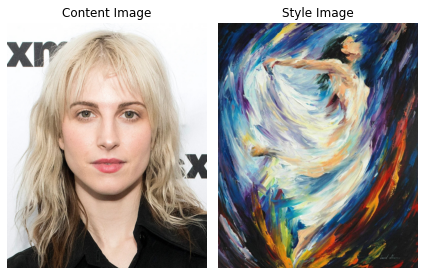

iteration: 10 loss: 57.739224489795916 time passed: 0:00:04.003895
iteration: 20 loss: 49.15785034013606 time passed: 0:00:08.753785
iteration: 30 loss: 42.166226757369614 time passed: 0:00:15.766606
iteration: 40 loss: 36.4716485260771 time passed: 0:00:19.948571
iteration: 50 loss: 31.97947619047619 time passed: 0:00:27.742314


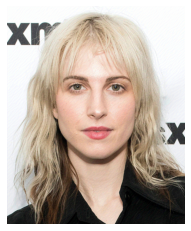

iteration: 60 loss: 28.507814058956917 time passed: 0:00:32.053063
iteration: 70 loss: 25.81504308390023 time passed: 0:00:37.284027
iteration: 80 loss: 23.67608843537415 time passed: 0:00:43.763861
iteration: 90 loss: 21.933390022675738 time passed: 0:00:48.510389
iteration: 100 loss: 20.48367573696145 time passed: 0:00:55.557715


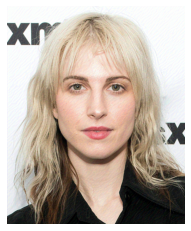

iteration: 110 loss: 19.253700680272107 time passed: 0:00:59.930628
iteration: 120 loss: 18.19221201814059 time passed: 0:01:07.513116
iteration: 130 loss: 17.26451700680272 time passed: 0:01:11.433995
iteration: 140 loss: 16.44399319727891 time passed: 0:01:16.768293
iteration: 150 loss: 15.711791383219955 time passed: 0:01:23.483934


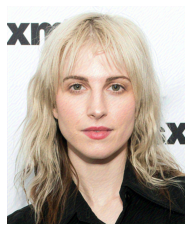

iteration: 160 loss: 15.052985260770974 time passed: 0:01:28.389750
iteration: 170 loss: 14.455843537414966 time passed: 0:01:35.404489
iteration: 180 loss: 13.911607709750568 time passed: 0:01:39.561770
iteration: 190 loss: 13.412619047619048 time passed: 0:01:47.137765
iteration: 200 loss: 12.95322902494331 time passed: 0:01:51.085920


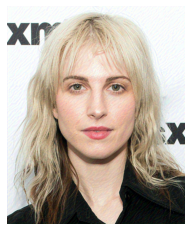

iteration: 210 loss: 12.528291383219955 time passed: 0:01:56.537181
iteration: 220 loss: 12.134074829931972 time passed: 0:02:03.026225
iteration: 230 loss: 11.767531746031747 time passed: 0:02:07.821840
iteration: 240 loss: 11.425528344671202 time passed: 0:02:15.125245
iteration: 250 loss: 11.105621315192744 time passed: 0:02:19.317238


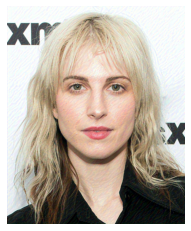

iteration: 260 loss: 10.805722222222222 time passed: 0:02:27.086784
iteration: 270 loss: 10.523844671201815 time passed: 0:02:31.024221
iteration: 280 loss: 10.258460317460317 time passed: 0:02:36.306867
iteration: 290 loss: 10.008210884353742 time passed: 0:02:42.787292
iteration: 300 loss: 9.771938775510204 time passed: 0:02:47.505846


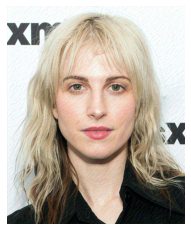

iteration: 310 loss: 9.548325396825398 time passed: 0:02:54.706057
iteration: 320 loss: 9.336248866213152 time passed: 0:02:58.831671
iteration: 330 loss: 9.134756802721089 time passed: 0:03:06.342282
iteration: 340 loss: 8.94312925170068 time passed: 0:03:10.415301
iteration: 350 loss: 8.76062074829932 time passed: 0:03:15.769616


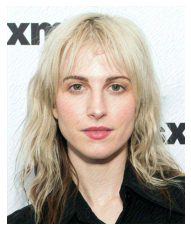

iteration: 360 loss: 8.586562925170067 time passed: 0:03:22.442313
iteration: 370 loss: 8.420320861678004 time passed: 0:03:27.155543
iteration: 380 loss: 8.26130612244898 time passed: 0:03:34.189052
iteration: 390 loss: 8.108910997732426 time passed: 0:03:38.363031
iteration: 400 loss: 7.96272052154195 time passed: 0:03:45.959100


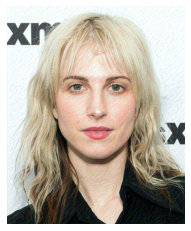

iteration: 410 loss: 7.822271541950113 time passed: 0:03:50.033108
iteration: 420 loss: 7.687047619047619 time passed: 0:03:55.326547
iteration: 430 loss: 7.556696712018141 time passed: 0:04:02.006732
iteration: 440 loss: 7.430984126984127 time passed: 0:04:06.898624
iteration: 450 loss: 7.3095787981859415 time passed: 0:04:13.933133


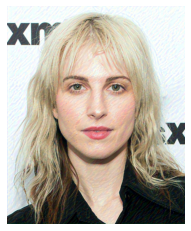

iteration: 460 loss: 7.192109977324263 time passed: 0:04:18.244132
iteration: 470 loss: 7.078316893424036 time passed: 0:04:25.810116
iteration: 480 loss: 6.9679189342403625 time passed: 0:04:29.751536
iteration: 490 loss: 6.860678004535147 time passed: 0:04:35.035694
iteration: 500 loss: 6.756380952380953 time passed: 0:04:41.481055


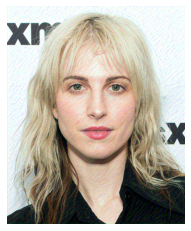

iteration: 510 loss: 6.654899092970521 time passed: 0:04:46.413498
iteration: 520 loss: 6.55599433106576 time passed: 0:04:53.567883
iteration: 530 loss: 6.459481292517006 time passed: 0:04:57.979917
iteration: 540 loss: 6.36524716553288 time passed: 0:05:05.516828
iteration: 550 loss: 6.273147959183674 time passed: 0:05:09.442246


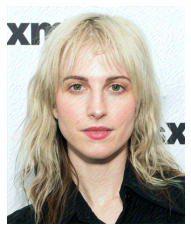

iteration: 560 loss: 6.183065192743764 time passed: 0:05:14.877970
iteration: 570 loss: 6.0948820861678 time passed: 0:05:21.320943
iteration: 580 loss: 6.00850283446712 time passed: 0:05:26.011122
iteration: 590 loss: 5.923829365079365 time passed: 0:05:32.973300
iteration: 600 loss: 5.840734693877551 time passed: 0:05:37.126202


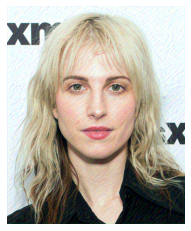

iteration: 610 loss: 5.7591434240362815 time passed: 0:05:45.088993
iteration: 620 loss: 5.679000566893424 time passed: 0:05:49.150342
iteration: 630 loss: 5.600231859410431 time passed: 0:05:54.403557
iteration: 640 loss: 5.522770975056689 time passed: 0:06:00.856750
iteration: 650 loss: 5.446581065759637 time passed: 0:06:05.594635


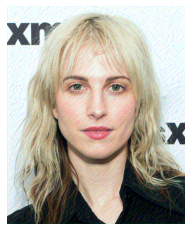

iteration: 660 loss: 5.371565192743764 time passed: 0:06:12.783122
iteration: 670 loss: 5.297681972789116 time passed: 0:06:16.973224
iteration: 680 loss: 5.2248871882086165 time passed: 0:06:24.526811
iteration: 690 loss: 5.15315589569161 time passed: 0:06:28.457683
iteration: 700 loss: 5.08248185941043 time passed: 0:06:33.725697


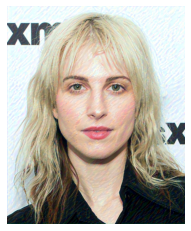

iteration: 710 loss: 5.012810090702948 time passed: 0:06:40.259493
iteration: 720 loss: 4.944093537414966 time passed: 0:06:45.041594
iteration: 730 loss: 4.87634410430839 time passed: 0:06:52.161986
iteration: 740 loss: 4.809519841269841 time passed: 0:06:56.323825
iteration: 750 loss: 4.743614229024943 time passed: 0:07:03.893039


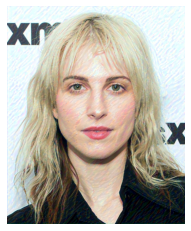

iteration: 760 loss: 4.678580498866213 time passed: 0:07:07.971732
iteration: 770 loss: 4.614402777777777 time passed: 0:07:13.264539
iteration: 780 loss: 4.551082766439909 time passed: 0:07:19.725633
iteration: 790 loss: 4.488622448979592 time passed: 0:07:24.438228
iteration: 800 loss: 4.42699716553288 time passed: 0:07:31.480358


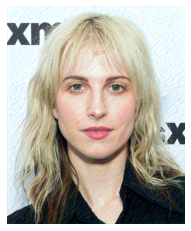

iteration: 810 loss: 4.366199829931973 time passed: 0:07:36.018995
iteration: 820 loss: 4.306223639455783 time passed: 0:07:43.799049
iteration: 830 loss: 4.247066609977324 time passed: 0:07:47.734186
iteration: 840 loss: 4.188731292517007 time passed: 0:07:53.059610
iteration: 850 loss: 4.131200680272109 time passed: 0:07:59.536385


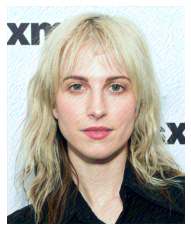

iteration: 860 loss: 4.0744897959183675 time passed: 0:08:04.401069
iteration: 870 loss: 4.018569160997733 time passed: 0:08:11.435554
iteration: 880 loss: 3.9634455782312927 time passed: 0:08:15.627279
iteration: 890 loss: 3.909107709750567 time passed: 0:08:23.202758
iteration: 900 loss: 3.855547052154195 time passed: 0:08:27.233750


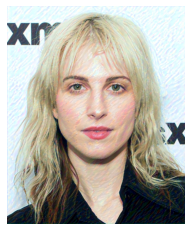

iteration: 910 loss: 3.8027743764172337 time passed: 0:08:32.910832
iteration: 920 loss: 3.750776927437642 time passed: 0:08:39.380022
iteration: 930 loss: 3.699549036281179 time passed: 0:08:44.107264
iteration: 940 loss: 3.649109410430839 time passed: 0:08:51.094107
iteration: 950 loss: 3.599464002267574 time passed: 0:08:55.244881


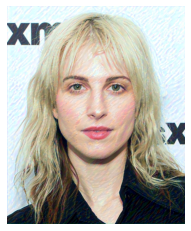

iteration: 960 loss: 3.550609410430839 time passed: 0:09:02.943286
iteration: 970 loss: 3.502545068027211 time passed: 0:09:06.875968
iteration: 980 loss: 3.4552582199546484 time passed: 0:09:12.159459
iteration: 990 loss: 3.4087531179138324 time passed: 0:09:18.732982
iteration: 1000 loss: 3.3630331632653063 time passed: 0:09:23.576731


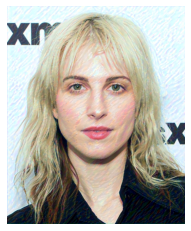

iteration: 1010 loss: 3.318092403628118 time passed: 0:09:30.768972
iteration: 1020 loss: 3.2739265873015873 time passed: 0:09:34.915416
iteration: 1030 loss: 3.230530612244898 time passed: 0:09:42.448663
iteration: 1040 loss: 3.187907029478458 time passed: 0:09:46.347740
iteration: 1050 loss: 3.146045918367347 time passed: 0:09:51.598639


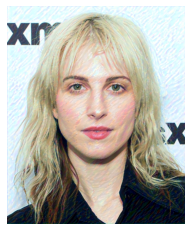

iteration: 1060 loss: 3.1049467120181404 time passed: 0:09:58.208495
iteration: 1070 loss: 3.0646170634920633 time passed: 0:10:02.907321
iteration: 1080 loss: 3.0250496031746033 time passed: 0:10:09.872365
iteration: 1090 loss: 2.9862290249433108 time passed: 0:10:13.971700
iteration: 1100 loss: 2.9481669501133787 time passed: 0:10:21.388706


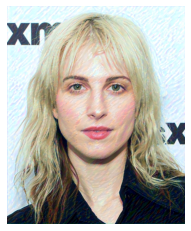

iteration: 1110 loss: 2.910857709750567 time passed: 0:10:25.392034
iteration: 1120 loss: 2.874294501133787 time passed: 0:10:30.607760
iteration: 1130 loss: 2.8384719387755104 time passed: 0:10:37.003086
iteration: 1140 loss: 2.8033832199546485 time passed: 0:10:41.697803
iteration: 1150 loss: 2.7690249433106575 time passed: 0:10:48.673852


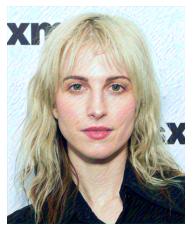

iteration: 1160 loss: 2.7353849206349206 time passed: 0:10:52.978698
iteration: 1170 loss: 2.702457766439909 time passed: 0:11:00.534143
iteration: 1180 loss: 2.670234977324263 time passed: 0:11:04.465258
iteration: 1190 loss: 2.638702380952381 time passed: 0:11:09.739630
iteration: 1200 loss: 2.607857426303855 time passed: 0:11:16.213738


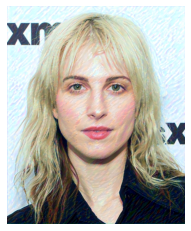

iteration: 1210 loss: 2.577687358276644 time passed: 0:11:21.090980
iteration: 1220 loss: 2.5481856575963717 time passed: 0:11:28.128963
iteration: 1230 loss: 2.5193429705215418 time passed: 0:11:32.304537
iteration: 1240 loss: 2.4911502267573695 time passed: 0:11:39.879272
iteration: 1250 loss: 2.4636009070294786 time passed: 0:11:43.821541


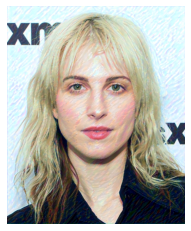

iteration: 1260 loss: 2.4366785714285712 time passed: 0:11:49.244816
iteration: 1270 loss: 2.410378117913832 time passed: 0:11:55.721488
iteration: 1280 loss: 2.3846896258503403 time passed: 0:12:00.449896
iteration: 1290 loss: 2.359595096371882 time passed: 0:12:07.467025
iteration: 1300 loss: 2.3350854591836736 time passed: 0:12:11.654153


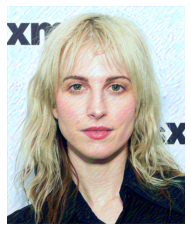

iteration: 1310 loss: 2.31115306122449 time passed: 0:12:19.365253
iteration: 1320 loss: 2.2877848639455785 time passed: 0:12:23.294464
iteration: 1330 loss: 2.2649723639455783 time passed: 0:12:28.589972
iteration: 1340 loss: 2.242701530612245 time passed: 0:12:35.053472
iteration: 1350 loss: 2.220963860544218 time passed: 0:12:39.797208


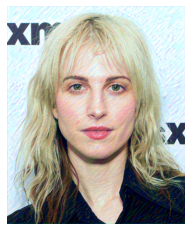

iteration: 1360 loss: 2.1997487244897957 time passed: 0:12:46.964264
iteration: 1370 loss: 2.1790429421768707 time passed: 0:12:51.145019
iteration: 1380 loss: 2.1588333333333334 time passed: 0:12:58.714890
iteration: 1390 loss: 2.1391099773242632 time passed: 0:13:02.663904
iteration: 1400 loss: 2.1198636621315194 time passed: 0:13:07.944907


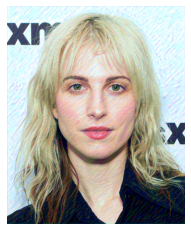

iteration: 1410 loss: 2.1010830498866215 time passed: 0:13:14.683426
iteration: 1420 loss: 2.0827546768707483 time passed: 0:13:19.403295
iteration: 1430 loss: 2.064869189342404 time passed: 0:13:26.396055
iteration: 1440 loss: 2.0474179421768706 time passed: 0:13:30.568810
iteration: 1450 loss: 2.030386763038549 time passed: 0:13:38.168764


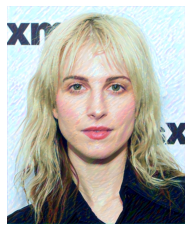

iteration: 1460 loss: 2.013765447845805 time passed: 0:13:42.259763
iteration: 1470 loss: 1.997547052154195 time passed: 0:13:47.551437
iteration: 1480 loss: 1.9817206632653062 time passed: 0:13:54.076506
iteration: 1490 loss: 1.9662732426303855 time passed: 0:13:58.867593
iteration: 1500 loss: 1.9511965702947847 time passed: 0:14:05.995483


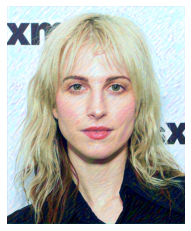

iteration: 1510 loss: 1.9364800170068026 time passed: 0:14:10.388666
iteration: 1520 loss: 1.9221157879818593 time passed: 0:14:18.115455
iteration: 1530 loss: 1.9080970804988662 time passed: 0:14:22.125230
iteration: 1540 loss: 1.8944094387755102 time passed: 0:14:27.501704
iteration: 1550 loss: 1.8810429421768708 time passed: 0:14:34.104784


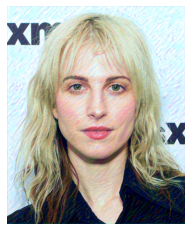

iteration: 1560 loss: 1.8679869614512472 time passed: 0:14:39.068668
iteration: 1570 loss: 1.855233134920635 time passed: 0:14:46.232948
iteration: 1580 loss: 1.8427740929705216 time passed: 0:14:50.496596
iteration: 1590 loss: 1.8306000566893423 time passed: 0:14:58.208826
iteration: 1600 loss: 1.818703798185941 time passed: 0:15:02.182345


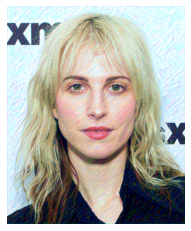

iteration: 1610 loss: 1.807075963718821 time passed: 0:15:07.696941
iteration: 1620 loss: 1.7957111678004536 time passed: 0:15:14.238174
iteration: 1630 loss: 1.7846020408163266 time passed: 0:15:19.050780
iteration: 1640 loss: 1.7737385204081633 time passed: 0:15:26.164202
iteration: 1650 loss: 1.763109693877551 time passed: 0:15:30.368284


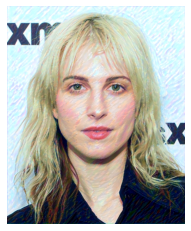

iteration: 1660 loss: 1.7527066326530611 time passed: 0:15:38.135337
iteration: 1670 loss: 1.7425228174603176 time passed: 0:15:42.072410
iteration: 1680 loss: 1.7325524376417234 time passed: 0:15:47.361651
iteration: 1690 loss: 1.7227871315192744 time passed: 0:15:53.876001
iteration: 1700 loss: 1.7132223639455781 time passed: 0:15:58.640078


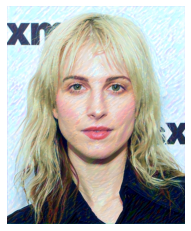

iteration: 1710 loss: 1.7038483560090703 time passed: 0:16:05.890901
iteration: 1720 loss: 1.6946585884353742 time passed: 0:16:10.113682
iteration: 1730 loss: 1.6856468253968253 time passed: 0:16:17.790973
iteration: 1740 loss: 1.6768090986394557 time passed: 0:16:21.791980
iteration: 1750 loss: 1.6681393140589569 time passed: 0:16:27.166455


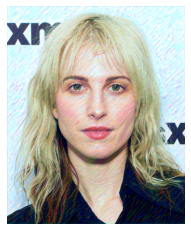

iteration: 1760 loss: 1.6596309523809525 time passed: 0:16:33.941449
iteration: 1770 loss: 1.6512783446712018 time passed: 0:16:38.744723
iteration: 1780 loss: 1.643080073696145 time passed: 0:16:45.892978
iteration: 1790 loss: 1.6350272108843538 time passed: 0:16:50.148559
iteration: 1800 loss: 1.6271191893424037 time passed: 0:16:57.849871


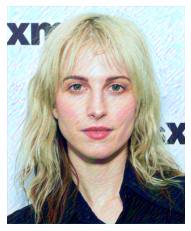

iteration: 1810 loss: 1.6193486394557823 time passed: 0:17:01.988977
iteration: 1820 loss: 1.6117118764172336 time passed: 0:17:07.382348
iteration: 1830 loss: 1.6041998299319729 time passed: 0:17:13.970841
iteration: 1840 loss: 1.596809523809524 time passed: 0:17:18.797264
iteration: 1850 loss: 1.5895368480725625 time passed: 0:17:25.965430


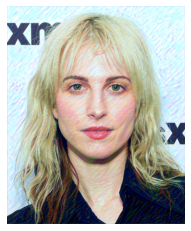

iteration: 1860 loss: 1.582378117913832 time passed: 0:17:30.379494
iteration: 1870 loss: 1.5753289399092971 time passed: 0:17:38.096527
iteration: 1880 loss: 1.5683861961451246 time passed: 0:17:42.113353
iteration: 1890 loss: 1.5615481859410432 time passed: 0:17:47.517586
iteration: 1900 loss: 1.5548089569160999 time passed: 0:17:54.108448


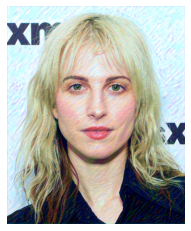

iteration: 1910 loss: 1.5481663832199546 time passed: 0:17:59.078716
iteration: 1920 loss: 1.5416174886621314 time passed: 0:18:06.225772
iteration: 1930 loss: 1.5351581632653062 time passed: 0:18:10.471293
iteration: 1940 loss: 1.5287850056689343 time passed: 0:18:18.177390
iteration: 1950 loss: 1.5224947562358278 time passed: 0:18:22.181979


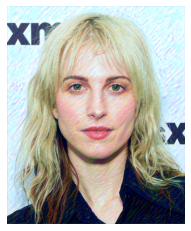

iteration: 1960 loss: 1.5162842970521542 time passed: 0:18:27.729748
iteration: 1970 loss: 1.5101522108843537 time passed: 0:18:34.307962
iteration: 1980 loss: 1.504095096371882 time passed: 0:18:39.089083
iteration: 1990 loss: 1.498109410430839 time passed: 0:18:46.215602
iteration: 2000 loss: 1.4921952947845805 time passed: 0:18:50.462971


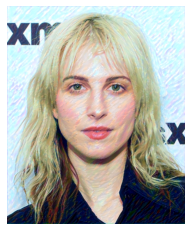

iteration: 2010 loss: 1.4863494897959184 time passed: 0:18:58.308122
iteration: 2020 loss: 1.4805688775510204 time passed: 0:19:02.300408
iteration: 2030 loss: 1.4748514739229024 time passed: 0:19:07.672316
iteration: 2040 loss: 1.4691969954648527 time passed: 0:19:14.243921
iteration: 2050 loss: 1.4636024659863947 time passed: 0:19:19.038598


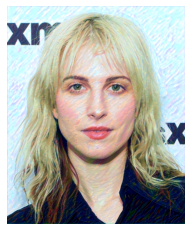

iteration: 2060 loss: 1.4580646258503402 time passed: 0:19:26.292276
iteration: 2070 loss: 1.4525843253968254 time passed: 0:19:30.535868
iteration: 2080 loss: 1.447158304988662 time passed: 0:19:38.218549
iteration: 2090 loss: 1.4417852891156462 time passed: 0:19:42.218294
iteration: 2100 loss: 1.4364628684807257 time passed: 0:19:47.586047


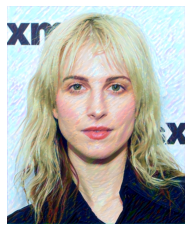

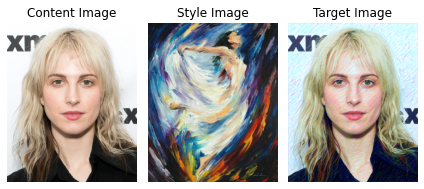

Training is started for learning rate: 0.002


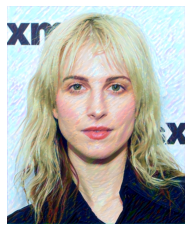

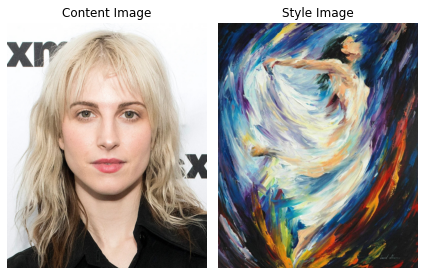

iteration: 10 loss: 39.07201814058957 time passed: 0:00:04.001939
iteration: 20 loss: 25.472920634920634 time passed: 0:00:08.811280
iteration: 30 loss: 19.433455782312926 time passed: 0:00:15.929007
iteration: 40 loss: 15.966933106575963 time passed: 0:00:20.166202
iteration: 50 loss: 13.631409297052155 time passed: 0:00:27.834177


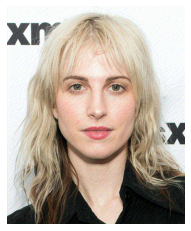

iteration: 60 loss: 11.965095238095238 time passed: 0:00:32.059647
iteration: 70 loss: 10.717675736961452 time passed: 0:00:37.416157
iteration: 80 loss: 9.746975056689342 time passed: 0:00:43.970357
iteration: 90 loss: 8.968613945578232 time passed: 0:00:48.756331
iteration: 100 loss: 8.327947278911564 time passed: 0:00:55.883586


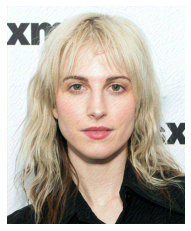

iteration: 110 loss: 7.7870419501133785 time passed: 0:01:00.263353
iteration: 120 loss: 7.321121315192744 time passed: 0:01:07.949386
iteration: 130 loss: 6.911797052154195 time passed: 0:01:11.932230
iteration: 140 loss: 6.545343537414966 time passed: 0:01:17.277388
iteration: 150 loss: 6.212676870748299 time passed: 0:01:23.853537


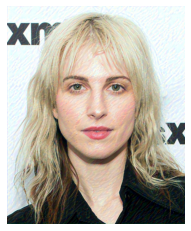

iteration: 160 loss: 5.906734126984127 time passed: 0:01:28.802777
iteration: 170 loss: 5.622221655328798 time passed: 0:01:35.916104
iteration: 180 loss: 5.355186507936508 time passed: 0:01:40.150473
iteration: 190 loss: 5.102664965986395 time passed: 0:01:47.835711
iteration: 200 loss: 4.862918934240363 time passed: 0:01:51.814990


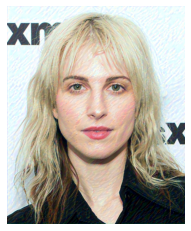

iteration: 210 loss: 4.634784013605442 time passed: 0:01:57.305225
iteration: 220 loss: 4.417424603174603 time passed: 0:02:03.891871
iteration: 230 loss: 4.210362811791383 time passed: 0:02:08.703831
iteration: 240 loss: 4.013455498866213 time passed: 0:02:15.830204
iteration: 250 loss: 3.826704931972789 time passed: 0:02:20.073556


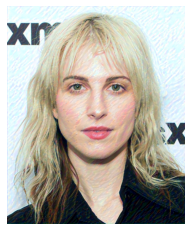

iteration: 260 loss: 3.650047052154195 time passed: 0:02:27.935553
iteration: 270 loss: 3.483301020408163 time passed: 0:02:31.930315
iteration: 280 loss: 3.3263715986394558 time passed: 0:02:37.313835
iteration: 290 loss: 3.179190476190476 time passed: 0:02:43.897204
iteration: 300 loss: 3.0415547052154195 time passed: 0:02:48.705336


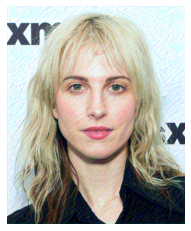

iteration: 310 loss: 2.913247448979592 time passed: 0:02:56.005798
iteration: 320 loss: 2.793950113378685 time passed: 0:03:00.256676
iteration: 330 loss: 2.68331462585034 time passed: 0:03:07.981259
iteration: 340 loss: 2.58099716553288 time passed: 0:03:11.993034
iteration: 350 loss: 2.4865850340136055 time passed: 0:03:17.327035


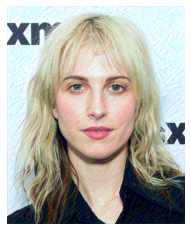

iteration: 360 loss: 2.39959126984127 time passed: 0:03:24.005297
iteration: 370 loss: 2.3195388321995463 time passed: 0:03:28.757315
iteration: 380 loss: 2.2459668367346937 time passed: 0:03:35.842732
iteration: 390 loss: 2.1784005102040815 time passed: 0:03:40.057319
iteration: 400 loss: 2.1163622448979593 time passed: 0:03:47.717826


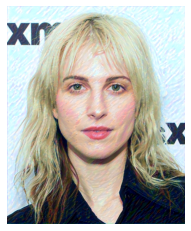

iteration: 410 loss: 2.0593922902494333 time passed: 0:03:51.871230
iteration: 420 loss: 2.007042091836735 time passed: 0:03:57.233202
iteration: 430 loss: 1.9589131235827664 time passed: 0:04:03.848902
iteration: 440 loss: 1.9146281179138323 time passed: 0:04:08.672132
iteration: 450 loss: 1.873815617913832 time passed: 0:04:15.833241


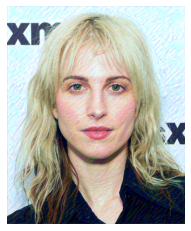

iteration: 460 loss: 1.8361364795918367 time passed: 0:04:20.241702
iteration: 470 loss: 1.8012901077097505 time passed: 0:04:27.981621
iteration: 480 loss: 1.7689737811791384 time passed: 0:04:31.981878
iteration: 490 loss: 1.7389142573696146 time passed: 0:04:37.363136
iteration: 500 loss: 1.7108633786848073 time passed: 0:04:43.957285


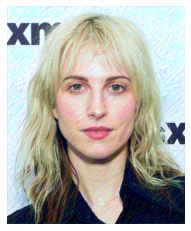

iteration: 510 loss: 1.6846033163265306 time passed: 0:04:48.908734
iteration: 520 loss: 1.6599475623582767 time passed: 0:04:56.054609
iteration: 530 loss: 1.6367240646258503 time passed: 0:05:00.319311
iteration: 540 loss: 1.6147786281179137 time passed: 0:05:08.058600
iteration: 550 loss: 1.5939709467120182 time passed: 0:05:12.064980


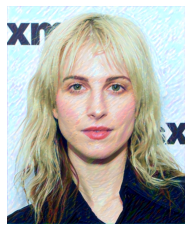

iteration: 560 loss: 1.5741792800453516 time passed: 0:05:17.602686
iteration: 570 loss: 1.5553032879818594 time passed: 0:05:24.195296
iteration: 580 loss: 1.5372521258503402 time passed: 0:05:29.002197
iteration: 590 loss: 1.5199486961451247 time passed: 0:05:36.182764
iteration: 600 loss: 1.5033061224489797 time passed: 0:05:40.431358


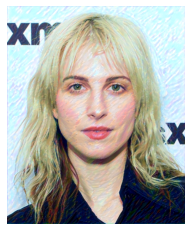

iteration: 610 loss: 1.487265589569161 time passed: 0:05:48.274925
iteration: 620 loss: 1.4717735260770974 time passed: 0:05:52.290110
iteration: 630 loss: 1.4567847222222223 time passed: 0:05:57.686397
iteration: 640 loss: 1.442251133786848 time passed: 0:06:04.290871
iteration: 650 loss: 1.4281371882086167 time passed: 0:06:09.114387


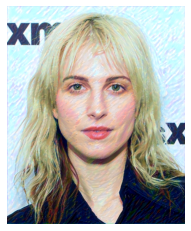

iteration: 660 loss: 1.4144163832199546 time passed: 0:06:16.448572
iteration: 670 loss: 1.4010503117913833 time passed: 0:06:20.708887
iteration: 680 loss: 1.388017573696145 time passed: 0:06:28.445031
iteration: 690 loss: 1.375299319727891 time passed: 0:06:32.451153
iteration: 700 loss: 1.3628694727891157 time passed: 0:06:37.825920


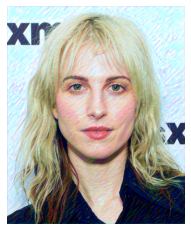

iteration: 710 loss: 1.3507164115646257 time passed: 0:06:44.577930
iteration: 720 loss: 1.3388241213151928 time passed: 0:06:49.384897
iteration: 730 loss: 1.3271771541950113 time passed: 0:06:56.543492
iteration: 740 loss: 1.3157597789115647 time passed: 0:07:00.798865
iteration: 750 loss: 1.3045582482993197 time passed: 0:07:08.496965


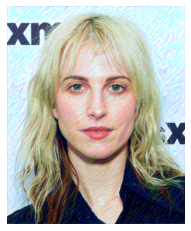

iteration: 760 loss: 1.2935585317460316 time passed: 0:07:12.645990
iteration: 770 loss: 1.2827522675736962 time passed: 0:07:18.029346
iteration: 780 loss: 1.2721322278911564 time passed: 0:07:24.625870
iteration: 790 loss: 1.2616914682539682 time passed: 0:07:29.419092
iteration: 800 loss: 1.251420068027211 time passed: 0:07:36.577657


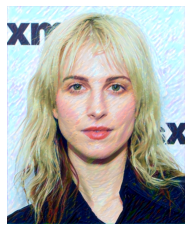

iteration: 810 loss: 1.241311649659864 time passed: 0:07:40.956720
iteration: 820 loss: 1.2313642290249434 time passed: 0:07:48.671805
iteration: 830 loss: 1.2215698696145125 time passed: 0:07:52.685311
iteration: 840 loss: 1.211921910430839 time passed: 0:07:58.049664
iteration: 850 loss: 1.2024163832199546 time passed: 0:08:04.634354


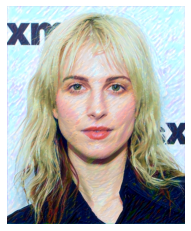

iteration: 860 loss: 1.193045351473923 time passed: 0:08:09.630143
iteration: 870 loss: 1.1838041383219955 time passed: 0:08:16.792873
iteration: 880 loss: 1.1746905470521543 time passed: 0:08:21.034916
iteration: 890 loss: 1.1656968537414967 time passed: 0:08:28.761967
iteration: 900 loss: 1.1568221371882086 time passed: 0:08:32.766562


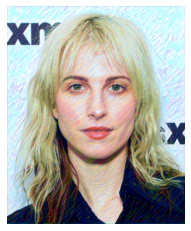

iteration: 910 loss: 1.1480607993197278 time passed: 0:08:38.301686
iteration: 920 loss: 1.1394086592970523 time passed: 0:08:44.879682
iteration: 930 loss: 1.1308635912698413 time passed: 0:08:49.711409
iteration: 940 loss: 1.122421130952381 time passed: 0:08:56.865582
iteration: 950 loss: 1.114078160430839 time passed: 0:09:01.114145


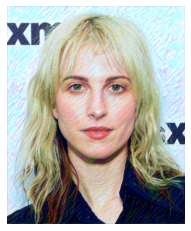

iteration: 960 loss: 1.1058326247165533 time passed: 0:09:09.086422
iteration: 970 loss: 1.0976855158730159 time passed: 0:09:13.101068
iteration: 980 loss: 1.0896366921768708 time passed: 0:09:18.491411
iteration: 990 loss: 1.0816850198412697 time passed: 0:09:25.070507
iteration: 1000 loss: 1.0738251842403628 time passed: 0:09:29.877575


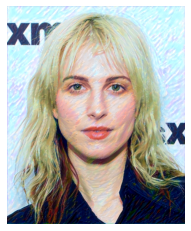

iteration: 1010 loss: 1.0660554138321996 time passed: 0:09:37.194748
iteration: 1020 loss: 1.058375921201814 time passed: 0:09:41.450413
iteration: 1030 loss: 1.0507847930839003 time passed: 0:09:49.153389
iteration: 1040 loss: 1.043282171201814 time passed: 0:09:53.162778
iteration: 1050 loss: 1.0358635204081632 time passed: 0:09:58.536120


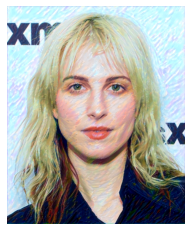

iteration: 1060 loss: 1.0285292658730159 time passed: 0:10:05.308055
iteration: 1070 loss: 1.0212769274376416 time passed: 0:10:10.117421
iteration: 1080 loss: 1.0141029620181405 time passed: 0:10:17.271230
iteration: 1090 loss: 1.0070051020408164 time passed: 0:10:21.533918
iteration: 1100 loss: 0.999983630952381 time passed: 0:10:29.276631


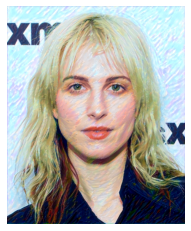

iteration: 1110 loss: 0.9930363520408163 time passed: 0:10:33.437359
iteration: 1120 loss: 0.9861612811791384 time passed: 0:10:38.811869
iteration: 1130 loss: 0.9793587018140589 time passed: 0:10:45.414375
iteration: 1140 loss: 0.9726271967120181 time passed: 0:10:50.243733
iteration: 1150 loss: 0.9659666950113379 time passed: 0:10:57.393045


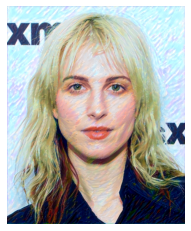

iteration: 1160 loss: 0.959375141723356 time passed: 0:11:01.789440
iteration: 1170 loss: 0.9528504818594105 time passed: 0:11:09.501961
iteration: 1180 loss: 0.9463920068027211 time passed: 0:11:13.493416
iteration: 1190 loss: 0.9399990787981859 time passed: 0:11:18.884149
iteration: 1200 loss: 0.9336737528344671 time passed: 0:11:25.481390


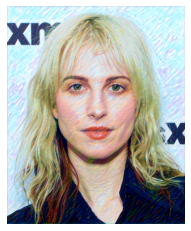

iteration: 1210 loss: 0.9274131235827664 time passed: 0:11:30.431885
iteration: 1220 loss: 0.9212150651927438 time passed: 0:11:37.587470
iteration: 1230 loss: 0.915078585600907 time passed: 0:11:41.839056
iteration: 1240 loss: 0.9090036139455783 time passed: 0:11:49.546120
iteration: 1250 loss: 0.9029910714285714 time passed: 0:11:53.552747


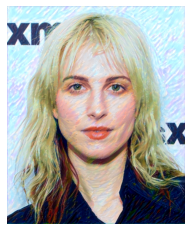

iteration: 1260 loss: 0.8970391156462585 time passed: 0:11:59.075606
iteration: 1270 loss: 0.8911458333333333 time passed: 0:12:05.652552
iteration: 1280 loss: 0.8853101615646258 time passed: 0:12:10.462007
iteration: 1290 loss: 0.8795301162131519 time passed: 0:12:17.600456
iteration: 1300 loss: 0.8738076105442177 time passed: 0:12:21.879663


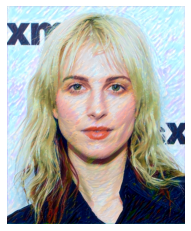

iteration: 1310 loss: 0.8681425028344671 time passed: 0:12:29.756895
iteration: 1320 loss: 0.8625335175736961 time passed: 0:12:33.777380
iteration: 1330 loss: 0.8569792375283447 time passed: 0:12:39.152980
iteration: 1340 loss: 0.8514790249433106 time passed: 0:12:45.761146
iteration: 1350 loss: 0.84603160430839 time passed: 0:12:50.574501


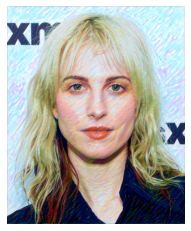

iteration: 1360 loss: 0.8406375425170068 time passed: 0:12:57.872252
iteration: 1370 loss: 0.835296343537415 time passed: 0:13:02.125512
iteration: 1380 loss: 0.8300067318594104 time passed: 0:13:09.852341
iteration: 1390 loss: 0.8247704081632653 time passed: 0:13:13.851416
iteration: 1400 loss: 0.8195851757369614 time passed: 0:13:19.235828


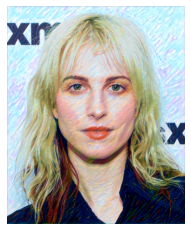

iteration: 1410 loss: 0.8144504676870749 time passed: 0:13:26.028261
iteration: 1420 loss: 0.8093660714285714 time passed: 0:13:30.862161
iteration: 1430 loss: 0.804327876984127 time passed: 0:13:38.045500
iteration: 1440 loss: 0.7993354591836734 time passed: 0:13:42.282937
iteration: 1450 loss: 0.7943897392290249 time passed: 0:13:49.998031


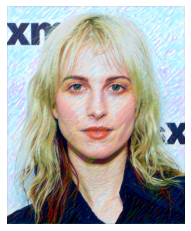

iteration: 1460 loss: 0.7894883786848073 time passed: 0:13:54.164821
iteration: 1470 loss: 0.7846313775510204 time passed: 0:13:59.536040
iteration: 1480 loss: 0.7798213577097506 time passed: 0:14:06.131341
iteration: 1490 loss: 0.7750552012471655 time passed: 0:14:10.933052
iteration: 1500 loss: 0.7703323412698413 time passed: 0:14:18.075518


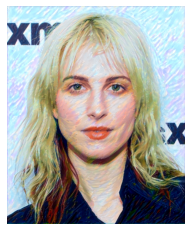

iteration: 1510 loss: 0.7656519982993197 time passed: 0:14:22.522208
iteration: 1520 loss: 0.761014455782313 time passed: 0:14:30.220827
iteration: 1530 loss: 0.7564187216553288 time passed: 0:14:34.229271
iteration: 1540 loss: 0.7518651502267574 time passed: 0:14:39.593496
iteration: 1550 loss: 0.7473526077097505 time passed: 0:14:46.179903


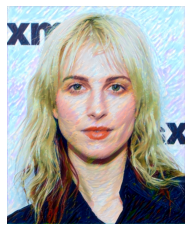

iteration: 1560 loss: 0.7428815192743764 time passed: 0:14:51.134053
iteration: 1570 loss: 0.7384517431972789 time passed: 0:14:58.267517
iteration: 1580 loss: 0.73406214569161 time passed: 0:15:02.508041
iteration: 1590 loss: 0.7297132227891157 time passed: 0:15:10.245528
iteration: 1600 loss: 0.7254046910430839 time passed: 0:15:14.250664


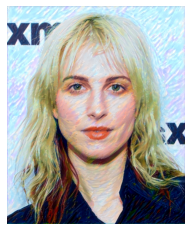

iteration: 1610 loss: 0.7211357709750567 time passed: 0:15:19.780406
iteration: 1620 loss: 0.716905399659864 time passed: 0:15:26.380667
iteration: 1630 loss: 0.7127130102040816 time passed: 0:15:31.202777
iteration: 1640 loss: 0.7085576814058957 time passed: 0:15:38.352428
iteration: 1650 loss: 0.7044384920634921 time passed: 0:15:42.593849


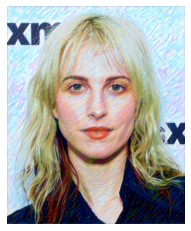

iteration: 1660 loss: 0.7003564342403628 time passed: 0:15:50.448121
iteration: 1670 loss: 0.69631179138322 time passed: 0:15:54.465700
iteration: 1680 loss: 0.6923030045351474 time passed: 0:15:59.839926
iteration: 1690 loss: 0.6883305697278912 time passed: 0:16:06.448385
iteration: 1700 loss: 0.6843913690476191 time passed: 0:16:11.257355


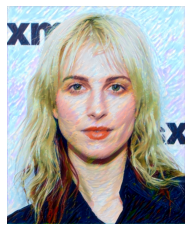

iteration: 1710 loss: 0.6804873866213151 time passed: 0:16:18.556532
iteration: 1720 loss: 0.6766182681405896 time passed: 0:16:22.819716
iteration: 1730 loss: 0.6727833758503401 time passed: 0:16:30.530873
iteration: 1740 loss: 0.6689820719954649 time passed: 0:16:34.531300
iteration: 1750 loss: 0.6652130810657596 time passed: 0:16:39.915201


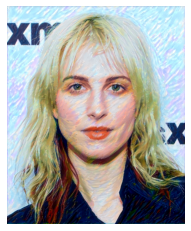

iteration: 1760 loss: 0.6614766865079366 time passed: 0:16:46.664428
iteration: 1770 loss: 0.6577726757369614 time passed: 0:16:51.460884
iteration: 1780 loss: 0.6541001984126984 time passed: 0:16:58.601457
iteration: 1790 loss: 0.6504589002267573 time passed: 0:17:02.834926
iteration: 1800 loss: 0.6468473639455782 time passed: 0:17:10.567763


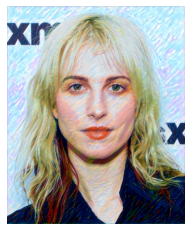

iteration: 1810 loss: 0.6432669359410431 time passed: 0:17:14.715292
iteration: 1820 loss: 0.6397159155328798 time passed: 0:17:20.060069
iteration: 1830 loss: 0.6361959325396825 time passed: 0:17:26.694425
iteration: 1840 loss: 0.6327057823129252 time passed: 0:17:31.499191
iteration: 1850 loss: 0.6292438350340136 time passed: 0:17:38.600334


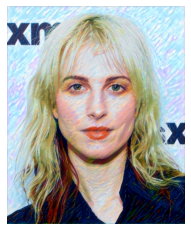

iteration: 1860 loss: 0.625811507936508 time passed: 0:17:43.088053
iteration: 1870 loss: 0.6224074546485261 time passed: 0:17:50.751644
iteration: 1880 loss: 0.619031108276644 time passed: 0:17:54.720977
iteration: 1890 loss: 0.6156833900226757 time passed: 0:18:00.064673
iteration: 1900 loss: 0.6123652210884354 time passed: 0:18:06.608393


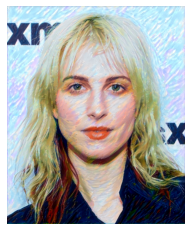

iteration: 1910 loss: 0.6090756094104308 time passed: 0:18:11.497026
iteration: 1920 loss: 0.6058132794784581 time passed: 0:18:18.561835
iteration: 1930 loss: 0.602577947845805 time passed: 0:18:22.760170
iteration: 1940 loss: 0.5993692602040817 time passed: 0:18:30.394811
iteration: 1950 loss: 0.5961863662131519 time passed: 0:18:34.383801


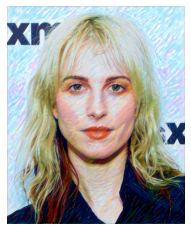

iteration: 1960 loss: 0.5930296201814059 time passed: 0:18:39.854084
iteration: 1970 loss: 0.5898985615079365 time passed: 0:18:46.422942
iteration: 1980 loss: 0.5867937216553288 time passed: 0:18:51.232806
iteration: 1990 loss: 0.5837147463151927 time passed: 0:18:58.386586
iteration: 2000 loss: 0.5806612103174603 time passed: 0:19:02.641697


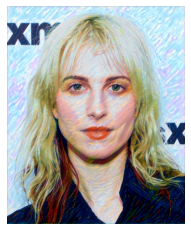

iteration: 2010 loss: 0.5776327593537415 time passed: 0:19:10.517943
iteration: 2020 loss: 0.5746288619614512 time passed: 0:19:14.525167
iteration: 2030 loss: 0.5716494472789115 time passed: 0:19:19.917692
iteration: 2040 loss: 0.5686939484126984 time passed: 0:19:26.557609
iteration: 2050 loss: 0.5657620464852607 time passed: 0:19:31.394188


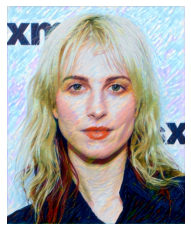

iteration: 2060 loss: 0.5628525722789116 time passed: 0:19:38.697002
iteration: 2070 loss: 0.5599668721655329 time passed: 0:19:42.965884
iteration: 2080 loss: 0.5571040603741496 time passed: 0:19:50.688546
iteration: 2090 loss: 0.5542649872448979 time passed: 0:19:54.699043
iteration: 2100 loss: 0.5514492630385488 time passed: 0:20:00.108608


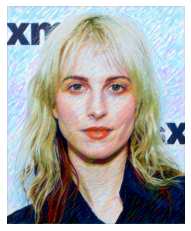

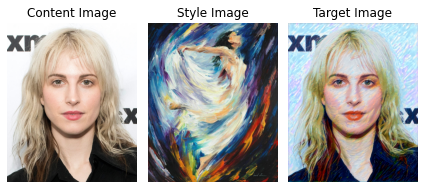

Training is started for learning rate: 0.005


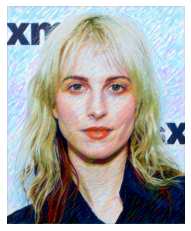

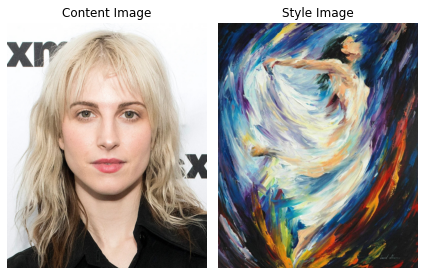

iteration: 10 loss: 24.020197278911564 time passed: 0:00:04.017608
iteration: 20 loss: 15.437973922902493 time passed: 0:00:08.837477
iteration: 30 loss: 11.227875283446712 time passed: 0:00:15.947273
iteration: 40 loss: 8.955208049886622 time passed: 0:00:20.196933
iteration: 50 loss: 7.573069160997733 time passed: 0:00:27.895216


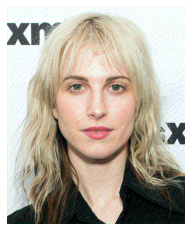

iteration: 60 loss: 6.615442176870748 time passed: 0:00:32.037790
iteration: 70 loss: 5.879639455782313 time passed: 0:00:37.408823
iteration: 80 loss: 5.268828798185941 time passed: 0:00:43.993968
iteration: 90 loss: 4.736996598639456 time passed: 0:00:48.780917
iteration: 100 loss: 4.2626935941043085 time passed: 0:00:55.911194


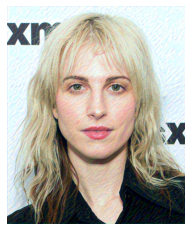

iteration: 110 loss: 3.8367366780045353 time passed: 0:01:00.312366
iteration: 120 loss: 3.457048752834467 time passed: 0:01:08.016108
iteration: 130 loss: 3.123433390022676 time passed: 0:01:12.016220
iteration: 140 loss: 2.8351011904761907 time passed: 0:01:17.385637
iteration: 150 loss: 2.590154761904762 time passed: 0:01:23.982126


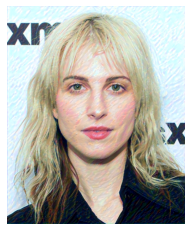

iteration: 160 loss: 2.3852219387755103 time passed: 0:01:28.947692
iteration: 170 loss: 2.215708758503401 time passed: 0:01:36.070984
iteration: 180 loss: 2.0763371598639457 time passed: 0:01:40.315540
iteration: 190 loss: 1.9619289965986395 time passed: 0:01:48.007112
iteration: 200 loss: 1.867671626984127 time passed: 0:01:52.027707


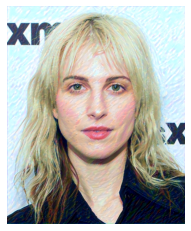

iteration: 210 loss: 1.789344529478458 time passed: 0:01:57.573772
iteration: 220 loss: 1.7234143990929705 time passed: 0:02:04.153863
iteration: 230 loss: 1.6670494614512472 time passed: 0:02:08.982741
iteration: 240 loss: 1.6179975907029478 time passed: 0:02:16.137434
iteration: 250 loss: 1.5745579648526078 time passed: 0:02:20.387053


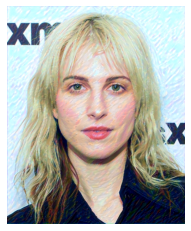

iteration: 260 loss: 1.5354793083900227 time passed: 0:02:28.241976
iteration: 270 loss: 1.4998330498866213 time passed: 0:02:32.240091
iteration: 280 loss: 1.4669312641723355 time passed: 0:02:37.615214
iteration: 290 loss: 1.4362745181405896 time passed: 0:02:44.198867
iteration: 300 loss: 1.4074982993197278 time passed: 0:02:48.993981


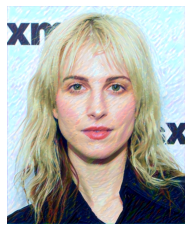

iteration: 310 loss: 1.3802830215419502 time passed: 0:02:56.273192
iteration: 320 loss: 1.3544152494331065 time passed: 0:03:00.523046
iteration: 330 loss: 1.3297328514739228 time passed: 0:03:08.217184
iteration: 340 loss: 1.3061132369614512 time passed: 0:03:12.215626
iteration: 350 loss: 1.283438350340136 time passed: 0:03:17.593283


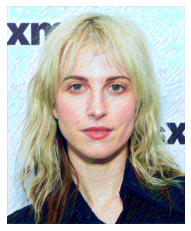

iteration: 360 loss: 1.2616367630385488 time passed: 0:03:24.336607
iteration: 370 loss: 1.2406309523809524 time passed: 0:03:29.140863
iteration: 380 loss: 1.2203391439909297 time passed: 0:03:36.292099
iteration: 390 loss: 1.2007071995464853 time passed: 0:03:40.532001
iteration: 400 loss: 1.1816910430839003 time passed: 0:03:48.228351


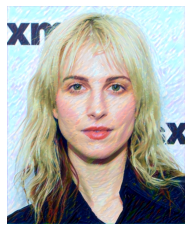

iteration: 410 loss: 1.1632483701814058 time passed: 0:03:52.509064
iteration: 420 loss: 1.1453400651927437 time passed: 0:03:57.874303
iteration: 430 loss: 1.1279298469387755 time passed: 0:04:04.453719
iteration: 440 loss: 1.1109899376417234 time passed: 0:04:09.294479
iteration: 450 loss: 1.0945068027210885 time passed: 0:04:16.432920


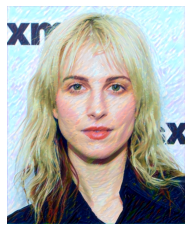

iteration: 460 loss: 1.078454577664399 time passed: 0:04:20.827801
iteration: 470 loss: 1.062798115079365 time passed: 0:04:28.533282
iteration: 480 loss: 1.0475196995464853 time passed: 0:04:32.531631
iteration: 490 loss: 1.0326045209750567 time passed: 0:04:37.894554
iteration: 500 loss: 1.018047760770975 time passed: 0:04:44.487539


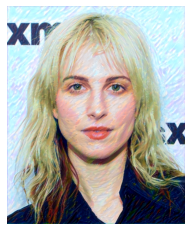

iteration: 510 loss: 1.0038359552154195 time passed: 0:04:49.446295
iteration: 520 loss: 0.9899579081632653 time passed: 0:04:56.581239
iteration: 530 loss: 0.9763983134920635 time passed: 0:05:00.835479
iteration: 540 loss: 0.9631490221088436 time passed: 0:05:08.545240
iteration: 550 loss: 0.9502017431972789 time passed: 0:05:12.550435


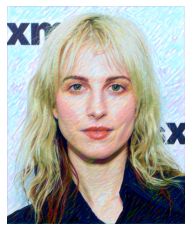

iteration: 560 loss: 0.9375482568027211 time passed: 0:05:18.078588
iteration: 570 loss: 0.9251766581632653 time passed: 0:05:24.663959
iteration: 580 loss: 0.9130827664399093 time passed: 0:05:29.459915
iteration: 590 loss: 0.9012561649659864 time passed: 0:05:36.613960
iteration: 600 loss: 0.889688633786848 time passed: 0:05:40.848700


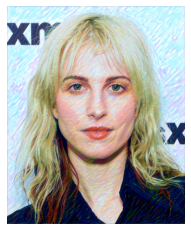

iteration: 610 loss: 0.8783673469387755 time passed: 0:05:48.704465
iteration: 620 loss: 0.8672903911564626 time passed: 0:05:52.709147
iteration: 630 loss: 0.8564510345804989 time passed: 0:05:58.077350
iteration: 640 loss: 0.8458391439909297 time passed: 0:06:04.654356
iteration: 650 loss: 0.8354516723356009 time passed: 0:06:09.473885


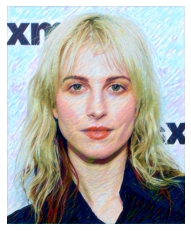

iteration: 660 loss: 0.8252829506802721 time passed: 0:06:16.752881
iteration: 670 loss: 0.8153256802721088 time passed: 0:06:21.004640
iteration: 680 loss: 0.8055739087301588 time passed: 0:06:28.729173
iteration: 690 loss: 0.7960218962585034 time passed: 0:06:32.731543
iteration: 700 loss: 0.7866636904761904 time passed: 0:06:38.100034


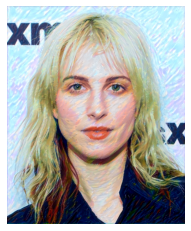

iteration: 710 loss: 0.7774924178004535 time passed: 0:06:44.866902
iteration: 720 loss: 0.7685019841269841 time passed: 0:06:49.687140
iteration: 730 loss: 0.7596905470521542 time passed: 0:06:56.822238
iteration: 740 loss: 0.7510503826530612 time passed: 0:07:01.080864
iteration: 750 loss: 0.742579648526077 time passed: 0:07:08.780004


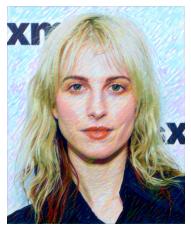

iteration: 760 loss: 0.7342728174603175 time passed: 0:07:12.943963
iteration: 770 loss: 0.726125992063492 time passed: 0:07:18.321809
iteration: 780 loss: 0.7181366921768707 time passed: 0:07:24.918014
iteration: 790 loss: 0.7103022959183674 time passed: 0:07:29.712169
iteration: 800 loss: 0.7026157879818594 time passed: 0:07:36.867993


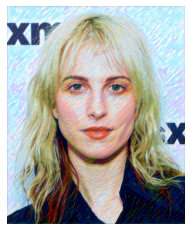

iteration: 810 loss: 0.6950734126984127 time passed: 0:07:41.266153
iteration: 820 loss: 0.687671768707483 time passed: 0:07:48.962913
iteration: 830 loss: 0.680406746031746 time passed: 0:07:52.959809
iteration: 840 loss: 0.6732772817460317 time passed: 0:07:58.328502
iteration: 850 loss: 0.6662785572562359 time passed: 0:08:04.892833


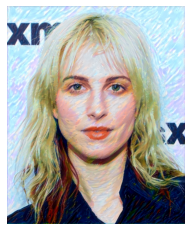

iteration: 860 loss: 0.6594078798185941 time passed: 0:08:09.866660
iteration: 870 loss: 0.6526625566893424 time passed: 0:08:17.003512
iteration: 880 loss: 0.6460371315192743 time passed: 0:08:21.258096
iteration: 890 loss: 0.6395285572562358 time passed: 0:08:28.977864
iteration: 900 loss: 0.6331337868480725 time passed: 0:08:32.991830


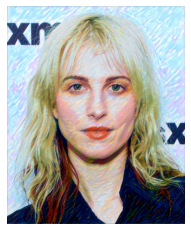

iteration: 910 loss: 0.6268486394557823 time passed: 0:08:38.487514
iteration: 920 loss: 0.6206737528344671 time passed: 0:08:45.058020
iteration: 930 loss: 0.6146053713151928 time passed: 0:08:49.863635
iteration: 940 loss: 0.6086435657596372 time passed: 0:08:56.985198
iteration: 950 loss: 0.6027860685941043 time passed: 0:09:01.235828


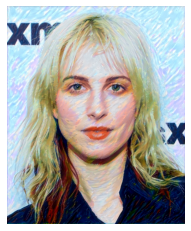

iteration: 960 loss: 0.597030753968254 time passed: 0:09:09.100413
iteration: 970 loss: 0.5913759566326531 time passed: 0:09:13.105754
iteration: 980 loss: 0.5858158304988662 time passed: 0:09:18.460113
iteration: 990 loss: 0.5803497732426304 time passed: 0:09:25.056179
iteration: 1000 loss: 0.5749752692743764 time passed: 0:09:29.869107


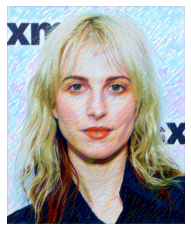

iteration: 1010 loss: 0.5696908304988663 time passed: 0:09:37.157524
iteration: 1020 loss: 0.5644924532312925 time passed: 0:09:41.407349
iteration: 1030 loss: 0.5593790036848073 time passed: 0:09:49.093945
iteration: 1040 loss: 0.5543475410997732 time passed: 0:09:53.108024
iteration: 1050 loss: 0.5493967899659864 time passed: 0:09:58.495723


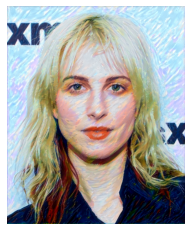

iteration: 1060 loss: 0.5445244472789116 time passed: 0:10:05.205714
iteration: 1070 loss: 0.5397300524376417 time passed: 0:10:10.027076
iteration: 1080 loss: 0.5350132157029478 time passed: 0:10:17.176224
iteration: 1090 loss: 0.5303711734693878 time passed: 0:10:21.429398
iteration: 1100 loss: 0.5258016935941043 time passed: 0:10:29.114589


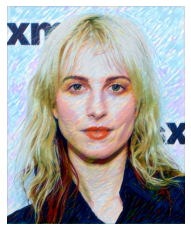

iteration: 1110 loss: 0.5213024022108843 time passed: 0:10:33.270472
iteration: 1120 loss: 0.5168725552721088 time passed: 0:10:38.642446
iteration: 1130 loss: 0.5125108064058957 time passed: 0:10:45.239861
iteration: 1140 loss: 0.5082159509637189 time passed: 0:10:50.028509
iteration: 1150 loss: 0.5039863236961452 time passed: 0:10:57.159032


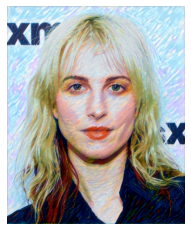

iteration: 1160 loss: 0.4998185232426304 time passed: 0:11:01.550659
iteration: 1170 loss: 0.49571276218820864 time passed: 0:11:09.270698
iteration: 1180 loss: 0.49166666666666664 time passed: 0:11:13.259001
iteration: 1190 loss: 0.4876786777210884 time passed: 0:11:18.645175
iteration: 1200 loss: 0.4837485119047619 time passed: 0:11:25.213464


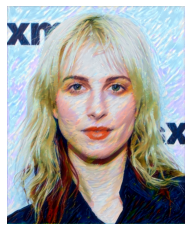

iteration: 1210 loss: 0.479874787414966 time passed: 0:11:30.169425
iteration: 1220 loss: 0.4760559807256236 time passed: 0:11:37.313591
iteration: 1230 loss: 0.47228961167800454 time passed: 0:11:41.569138
iteration: 1240 loss: 0.4685738732993197 time passed: 0:11:49.267131
iteration: 1250 loss: 0.46490855300453515 time passed: 0:11:53.265137


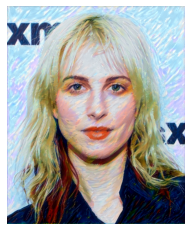

iteration: 1260 loss: 0.4612923398526077 time passed: 0:11:58.778097
iteration: 1270 loss: 0.45772300170068025 time passed: 0:12:05.355976
iteration: 1280 loss: 0.4541982001133787 time passed: 0:12:10.133790
iteration: 1290 loss: 0.45071875 time passed: 0:12:17.274041
iteration: 1300 loss: 0.4472846867913832 time passed: 0:12:21.511998


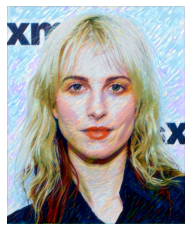

iteration: 1310 loss: 0.44389452239229027 time passed: 0:12:29.463777
iteration: 1320 loss: 0.44054584750566894 time passed: 0:12:33.463527
iteration: 1330 loss: 0.43723763463718823 time passed: 0:12:38.827841
iteration: 1340 loss: 0.433969246031746 time passed: 0:12:45.424478
iteration: 1350 loss: 0.43073947704081633 time passed: 0:12:50.241415


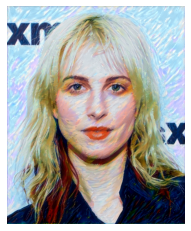

iteration: 1360 loss: 0.427547477324263 time passed: 0:12:57.502892
iteration: 1370 loss: 0.4243926445578231 time passed: 0:13:01.745970
iteration: 1380 loss: 0.42127264030612244 time passed: 0:13:09.449609
iteration: 1390 loss: 0.418187677154195 time passed: 0:13:13.459496
iteration: 1400 loss: 0.41513538123582766 time passed: 0:13:18.823818


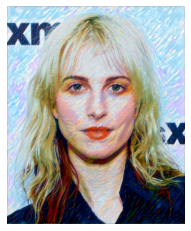

iteration: 1410 loss: 0.41211614229024945 time passed: 0:13:25.566310
iteration: 1420 loss: 0.4091294642857143 time passed: 0:13:30.389483
iteration: 1430 loss: 0.4061732213718821 time passed: 0:13:37.518716
iteration: 1440 loss: 0.4032483347505669 time passed: 0:13:41.767148
iteration: 1450 loss: 0.4003527140022676 time passed: 0:13:49.470825


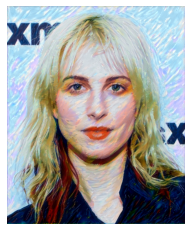

iteration: 1460 loss: 0.39748508361678003 time passed: 0:13:53.635299
iteration: 1470 loss: 0.39464647108843537 time passed: 0:13:59.004802
iteration: 1480 loss: 0.3918361678004535 time passed: 0:14:05.580283
iteration: 1490 loss: 0.3890527565192744 time passed: 0:14:10.358021
iteration: 1500 loss: 0.38629595379818593 time passed: 0:14:17.486619


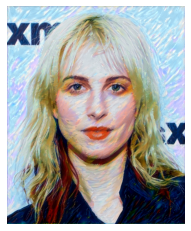

iteration: 1510 loss: 0.3835657242063492 time passed: 0:14:21.881867
iteration: 1520 loss: 0.3808613236961451 time passed: 0:14:29.580508
iteration: 1530 loss: 0.37818037840136054 time passed: 0:14:33.611915
iteration: 1540 loss: 0.3755231009070295 time passed: 0:14:38.982615
iteration: 1550 loss: 0.37288998724489797 time passed: 0:14:45.554906


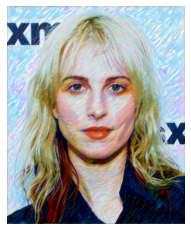

iteration: 1560 loss: 0.3702800453514739 time passed: 0:14:50.509837
iteration: 1570 loss: 0.3676944798752834 time passed: 0:14:57.641886
iteration: 1580 loss: 0.36513208616780046 time passed: 0:15:01.879436
iteration: 1590 loss: 0.3625922264739229 time passed: 0:15:09.594277
iteration: 1600 loss: 0.36007429846938777 time passed: 0:15:13.587945


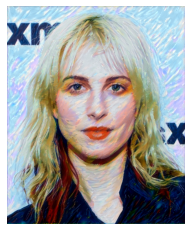

iteration: 1610 loss: 0.3575817389455782 time passed: 0:15:19.090566
iteration: 1620 loss: 0.3551062925170068 time passed: 0:15:25.689862
iteration: 1630 loss: 0.3526552579365079 time passed: 0:15:30.502200
iteration: 1640 loss: 0.3502232142857143 time passed: 0:15:37.646281
iteration: 1650 loss: 0.3478011975623583 time passed: 0:15:41.903596


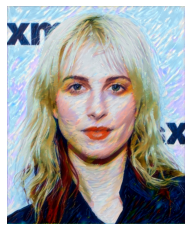

iteration: 1660 loss: 0.34547115929705213 time passed: 0:15:49.736860
iteration: 1670 loss: 0.34309484835600906 time passed: 0:15:53.734163
iteration: 1680 loss: 0.3406892361111111 time passed: 0:15:59.089397
iteration: 1690 loss: 0.3383718820861678 time passed: 0:16:05.665023
iteration: 1700 loss: 0.3362079081632653 time passed: 0:16:10.464674


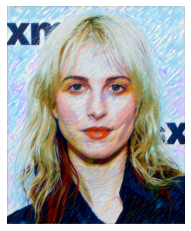

iteration: 1710 loss: 0.3339092261904762 time passed: 0:16:17.757849
iteration: 1720 loss: 0.3315206916099773 time passed: 0:16:21.996514
iteration: 1730 loss: 0.3291905824829932 time passed: 0:16:29.702976
iteration: 1740 loss: 0.32712553146258505 time passed: 0:16:33.694249
iteration: 1750 loss: 0.3250215419501134 time passed: 0:16:39.059669


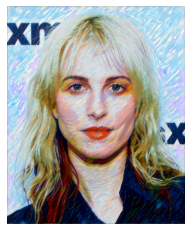

iteration: 1760 loss: 0.3226848426870748 time passed: 0:16:45.795266
iteration: 1770 loss: 0.32033740787981857 time passed: 0:16:50.604681
iteration: 1780 loss: 0.31818037840136054 time passed: 0:16:57.726170
iteration: 1790 loss: 0.3164423185941043 time passed: 0:17:01.965287
iteration: 1800 loss: 0.3141768353174603 time passed: 0:17:09.681932


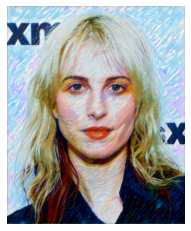

iteration: 1810 loss: 0.3118313492063492 time passed: 0:17:13.833656
iteration: 1820 loss: 0.30958939200680274 time passed: 0:17:19.183325
iteration: 1830 loss: 0.3076193310657596 time passed: 0:17:25.785927
iteration: 1840 loss: 0.30604138321995467 time passed: 0:17:30.603472
iteration: 1850 loss: 0.3037039044784581 time passed: 0:17:37.718587


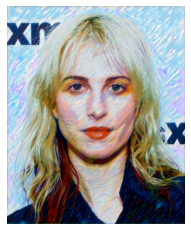

iteration: 1860 loss: 0.3013841765873016 time passed: 0:17:42.093114
iteration: 1870 loss: 0.2994312641723356 time passed: 0:17:49.789039
iteration: 1880 loss: 0.2973064767573696 time passed: 0:17:53.792770
iteration: 1890 loss: 0.2960810303287982 time passed: 0:17:59.159139
iteration: 1900 loss: 0.29376537698412697 time passed: 0:18:05.712906


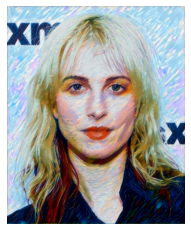

iteration: 1910 loss: 0.2915798611111111 time passed: 0:18:10.641771
iteration: 1920 loss: 0.28932362528344674 time passed: 0:18:17.783899
iteration: 1930 loss: 0.28733659297052155 time passed: 0:18:22.030543
iteration: 1940 loss: 0.28658081774376415 time passed: 0:18:29.746901
iteration: 1950 loss: 0.2840736784297052 time passed: 0:18:33.746673


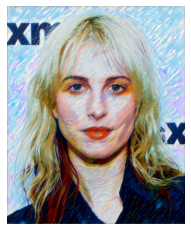

iteration: 1960 loss: 0.28217253047052154 time passed: 0:18:39.251589
iteration: 1970 loss: 0.2797699829931973 time passed: 0:18:45.810512
iteration: 1980 loss: 0.27798185941043085 time passed: 0:18:50.614081
iteration: 1990 loss: 0.2770275474773243 time passed: 0:18:57.740417
iteration: 2000 loss: 0.27463081065759637 time passed: 0:19:01.987223


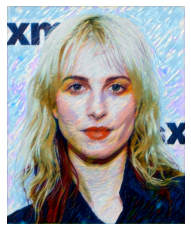

iteration: 2010 loss: 0.27235634566326533 time passed: 0:19:09.820251
iteration: 2020 loss: 0.2735606221655329 time passed: 0:19:13.821148
iteration: 2030 loss: 0.26940217545351475 time passed: 0:19:19.182708
iteration: 2040 loss: 0.26708198696145125 time passed: 0:19:25.775867
iteration: 2050 loss: 0.2659786529195011 time passed: 0:19:30.599582


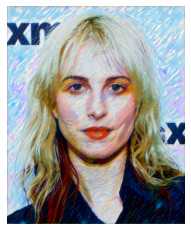

iteration: 2060 loss: 0.2641832482993197 time passed: 0:19:37.886900
iteration: 2070 loss: 0.2622856257086168 time passed: 0:19:42.136667
iteration: 2080 loss: 0.26010220025510206 time passed: 0:19:49.830730
iteration: 2090 loss: 0.2579953939909297 time passed: 0:19:53.826639
iteration: 2100 loss: 0.2602386975623583 time passed: 0:19:59.197630


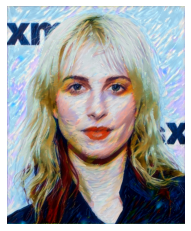

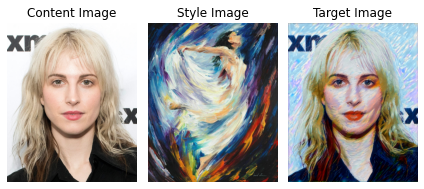

Training is started for learning rate: 0.01


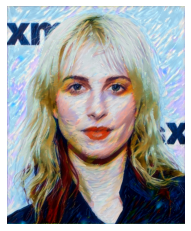

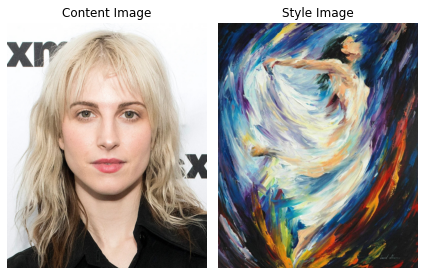

iteration: 10 loss: 17.802902494331065 time passed: 0:00:03.997197
iteration: 20 loss: 10.393693877551021 time passed: 0:00:08.800993
iteration: 30 loss: 7.442488662131519 time passed: 0:00:15.898921
iteration: 40 loss: 5.8753339002267575 time passed: 0:00:20.142507
iteration: 50 loss: 4.778501700680272 time passed: 0:00:27.819112


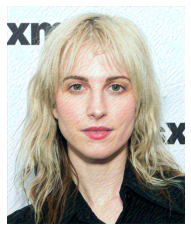

iteration: 60 loss: 3.926981009070295 time passed: 0:00:31.972281
iteration: 70 loss: 3.2529946145124717 time passed: 0:00:37.330459
iteration: 80 loss: 2.730842403628118 time passed: 0:00:43.902965
iteration: 90 loss: 2.3431041666666665 time passed: 0:00:48.680018
iteration: 100 loss: 2.0674146825396824 time passed: 0:00:56.219492


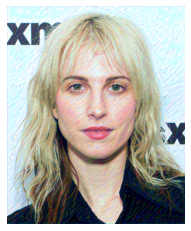

iteration: 110 loss: 1.8759098639455782 time passed: 0:01:00.619229
iteration: 120 loss: 1.7415688775510203 time passed: 0:01:08.299450
iteration: 130 loss: 1.6429244614512473 time passed: 0:01:12.291506
iteration: 140 loss: 1.5656741780045351 time passed: 0:01:17.672801
iteration: 150 loss: 1.501387755102041 time passed: 0:01:24.255941


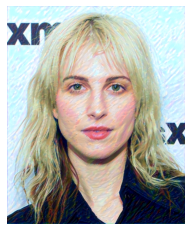

iteration: 160 loss: 1.4455185657596372 time passed: 0:01:29.215080
iteration: 170 loss: 1.3955854591836734 time passed: 0:01:36.355920
iteration: 180 loss: 1.350217970521542 time passed: 0:01:40.625052
iteration: 190 loss: 1.308470663265306 time passed: 0:01:48.323435
iteration: 200 loss: 1.2697322845804988 time passed: 0:01:52.333734


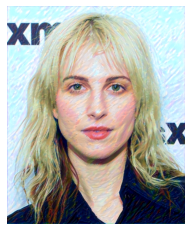

iteration: 210 loss: 1.233562074829932 time passed: 0:01:57.857677
iteration: 220 loss: 1.199594529478458 time passed: 0:02:04.435122
iteration: 230 loss: 1.1675110544217686 time passed: 0:02:09.248376
iteration: 240 loss: 1.1370814200680273 time passed: 0:02:16.372570
iteration: 250 loss: 1.108123724489796 time passed: 0:02:20.617872


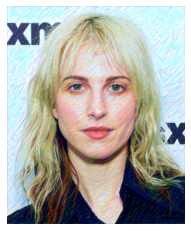

iteration: 260 loss: 1.0804965277777778 time passed: 0:02:28.474494
iteration: 270 loss: 1.0540810657596371 time passed: 0:02:32.480577
iteration: 280 loss: 1.0287916666666668 time passed: 0:02:37.853696
iteration: 290 loss: 1.0045436507936507 time passed: 0:02:44.440241
iteration: 300 loss: 0.981265164399093 time passed: 0:02:49.229086


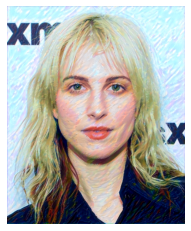

iteration: 310 loss: 0.9589030612244898 time passed: 0:02:56.515507
iteration: 320 loss: 0.9374022108843537 time passed: 0:03:00.748992
iteration: 330 loss: 0.9167198837868481 time passed: 0:03:08.437372
iteration: 340 loss: 0.8968198696145124 time passed: 0:03:12.432784
iteration: 350 loss: 0.8776590844671202 time passed: 0:03:17.790026


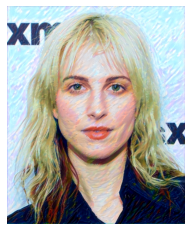

iteration: 360 loss: 0.8592108843537415 time passed: 0:03:24.543477
iteration: 370 loss: 0.8414393424036282 time passed: 0:03:29.331487
iteration: 380 loss: 0.8243137755102041 time passed: 0:03:36.467550
iteration: 390 loss: 0.8077923752834467 time passed: 0:03:40.708557
iteration: 400 loss: 0.7918467261904761 time passed: 0:03:48.419831


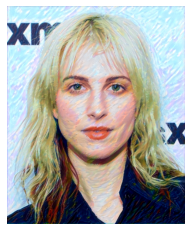

iteration: 410 loss: 0.7764591128117914 time passed: 0:03:52.572427
iteration: 420 loss: 0.7616027494331066 time passed: 0:03:57.938885
iteration: 430 loss: 0.7472513463718821 time passed: 0:04:04.526883
iteration: 440 loss: 0.7333850623582766 time passed: 0:04:09.324823
iteration: 450 loss: 0.7199803713151928 time passed: 0:04:16.466577


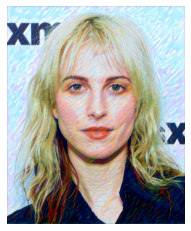

iteration: 460 loss: 0.7070190617913832 time passed: 0:04:20.859941
iteration: 470 loss: 0.6944751275510204 time passed: 0:04:28.580830
iteration: 480 loss: 0.6823363095238095 time passed: 0:04:32.580872
iteration: 490 loss: 0.6705864512471655 time passed: 0:04:37.934302
iteration: 500 loss: 0.659203514739229 time passed: 0:04:44.519368


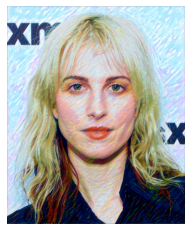

iteration: 510 loss: 0.6481742488662131 time passed: 0:04:49.482229
iteration: 520 loss: 0.6374856150793651 time passed: 0:04:56.596433
iteration: 530 loss: 0.6271201105442177 time passed: 0:05:00.825980
iteration: 540 loss: 0.6170654761904761 time passed: 0:05:08.522472
iteration: 550 loss: 0.6073107284580499 time passed: 0:05:12.520686


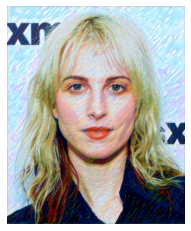

iteration: 560 loss: 0.597843679138322 time passed: 0:05:18.049286
iteration: 570 loss: 0.5886521754535148 time passed: 0:05:24.644220
iteration: 580 loss: 0.5798065476190476 time passed: 0:05:29.460466
iteration: 590 loss: 0.5710880810657596 time passed: 0:05:36.609854
iteration: 600 loss: 0.5630440759637189 time passed: 0:05:40.865414


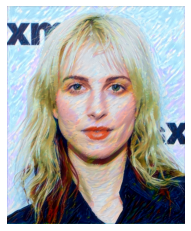

iteration: 610 loss: 0.5546463293650794 time passed: 0:05:48.722120
iteration: 620 loss: 0.5465429776077098 time passed: 0:05:52.725395
iteration: 630 loss: 0.5391376133786848 time passed: 0:05:58.094641
iteration: 640 loss: 0.5320952735260771 time passed: 0:06:04.680472
iteration: 650 loss: 0.5245960884353742 time passed: 0:06:09.495595


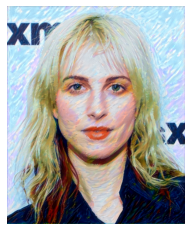

iteration: 660 loss: 0.5170034013605442 time passed: 0:06:16.811451
iteration: 670 loss: 0.509891121031746 time passed: 0:06:21.061836
iteration: 680 loss: 0.5048270266439909 time passed: 0:06:28.768615
iteration: 690 loss: 0.4971888818027211 time passed: 0:06:32.784018
iteration: 700 loss: 0.4918000283446712 time passed: 0:06:38.153635


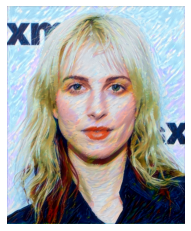

iteration: 710 loss: 0.48503358843537414 time passed: 0:06:44.893638
iteration: 720 loss: 0.4782299461451247 time passed: 0:06:49.709665
iteration: 730 loss: 0.4721459750566893 time passed: 0:06:56.833061
iteration: 740 loss: 0.46617431972789114 time passed: 0:07:01.079402
iteration: 750 loss: 0.4625359977324263 time passed: 0:07:08.778499


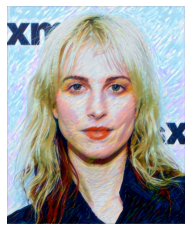

iteration: 760 loss: 0.4562793367346939 time passed: 0:07:12.939805
iteration: 770 loss: 0.45174500425170067 time passed: 0:07:18.308482
iteration: 780 loss: 0.4454590419501134 time passed: 0:07:24.902964
iteration: 790 loss: 0.4402908517573696 time passed: 0:07:29.701521
iteration: 800 loss: 0.4341518920068027 time passed: 0:07:36.844350


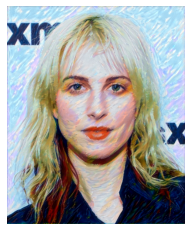

iteration: 810 loss: 0.43357128684807256 time passed: 0:07:41.399555
iteration: 820 loss: 0.4400035430839002 time passed: 0:07:49.100912
iteration: 830 loss: 0.4266422548185941 time passed: 0:07:53.102691
iteration: 840 loss: 0.41840869472789116 time passed: 0:07:58.480333
iteration: 850 loss: 0.41151714852607707 time passed: 0:08:05.078055


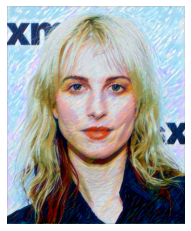

iteration: 860 loss: 0.40619596797052154 time passed: 0:08:10.039734
iteration: 870 loss: 0.40140380527210884 time passed: 0:08:17.197455
iteration: 880 loss: 0.4059828869047619 time passed: 0:08:21.495135
iteration: 890 loss: 0.3931282596371882 time passed: 0:08:29.213693
iteration: 900 loss: 0.38919897959183675 time passed: 0:08:33.215959


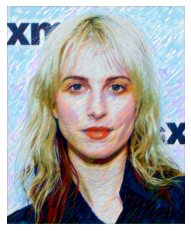

iteration: 910 loss: 0.38462687783446714 time passed: 0:08:38.744536
iteration: 920 loss: 0.38030573270975054 time passed: 0:08:45.343765
iteration: 930 loss: 0.37629503259637187 time passed: 0:08:50.164236
iteration: 940 loss: 0.3964651714852608 time passed: 0:08:57.307581
iteration: 950 loss: 0.37420358560090705 time passed: 0:09:01.554784


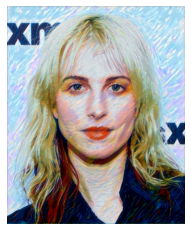

iteration: 960 loss: 0.36766978458049887 time passed: 0:09:09.437435
iteration: 970 loss: 0.36352058531746034 time passed: 0:09:13.439673
iteration: 980 loss: 0.35841181264172334 time passed: 0:09:18.825816
iteration: 990 loss: 0.3542701247165533 time passed: 0:09:25.408887
iteration: 1000 loss: 0.35118555130385487 time passed: 0:09:30.223723


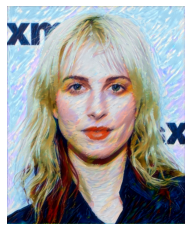

iteration: 1010 loss: 0.3495831561791383 time passed: 0:09:37.495131
iteration: 1020 loss: 0.343343608276644 time passed: 0:09:41.748396
iteration: 1030 loss: 0.3406596867913832 time passed: 0:09:49.456371
iteration: 1040 loss: 0.34057603458049884 time passed: 0:09:53.467480
iteration: 1050 loss: 0.33432394416099775 time passed: 0:09:58.836141


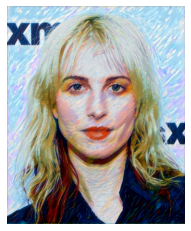

iteration: 1060 loss: 0.33101197562358275 time passed: 0:10:05.584100
iteration: 1070 loss: 0.32754265873015875 time passed: 0:10:10.387517
iteration: 1080 loss: 0.33489813633786847 time passed: 0:10:17.531621
iteration: 1090 loss: 0.3246965702947846 time passed: 0:10:21.780566
iteration: 1100 loss: 0.32069136196145126 time passed: 0:10:29.503677


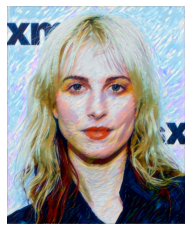

iteration: 1110 loss: 0.32194416099773243 time passed: 0:10:33.655720
iteration: 1120 loss: 0.3136888818027211 time passed: 0:10:39.024884
iteration: 1130 loss: 0.30904793792517005 time passed: 0:10:45.599766
iteration: 1140 loss: 0.30727129393424035 time passed: 0:10:50.409590
iteration: 1150 loss: 0.30336444160997733 time passed: 0:10:57.557954


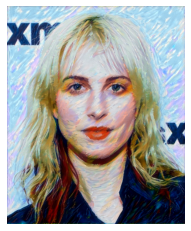

iteration: 1160 loss: 0.3005015235260771 time passed: 0:11:01.963625
iteration: 1170 loss: 0.29769820011337866 time passed: 0:11:09.696073
iteration: 1180 loss: 0.2986625921201814 time passed: 0:11:13.706599
iteration: 1190 loss: 0.29343362032312925 time passed: 0:11:19.072600
iteration: 1200 loss: 0.2888811295351474 time passed: 0:11:25.658660


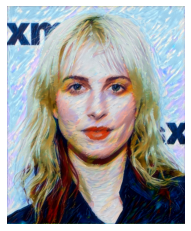

iteration: 1210 loss: 0.30295383361678 time passed: 0:11:30.641472
iteration: 1220 loss: 0.2871936649659864 time passed: 0:11:37.788487
iteration: 1230 loss: 0.28748184169501134 time passed: 0:11:42.037998
iteration: 1240 loss: 0.28079758361678003 time passed: 0:11:49.754795
iteration: 1250 loss: 0.27766904053287983 time passed: 0:11:53.747654


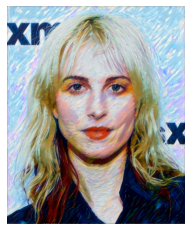

iteration: 1260 loss: 0.2739776962868481 time passed: 0:11:59.251137
iteration: 1270 loss: 0.2792232142857143 time passed: 0:12:05.843031
iteration: 1280 loss: 0.2854720450680272 time passed: 0:12:10.648721
iteration: 1290 loss: 0.27388885345804986 time passed: 0:12:17.796253
iteration: 1300 loss: 0.26452737032312923 time passed: 0:12:22.034891


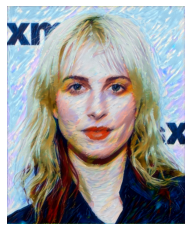

iteration: 1310 loss: 0.29731763747165535 time passed: 0:12:29.873823
iteration: 1320 loss: 0.2633075219671202 time passed: 0:12:33.876171
iteration: 1330 loss: 0.26079437712585035 time passed: 0:12:39.254323
iteration: 1340 loss: 0.25699518140589567 time passed: 0:12:45.829786
iteration: 1350 loss: 0.25395388676303854 time passed: 0:12:50.646352


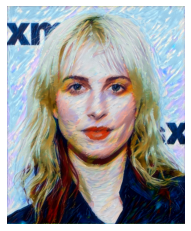

iteration: 1360 loss: 0.2510736961451247 time passed: 0:12:57.940850
iteration: 1370 loss: 0.2470468927154195 time passed: 0:13:02.171715
iteration: 1380 loss: 0.24547626133786848 time passed: 0:13:09.865297
iteration: 1390 loss: 0.24368473639455782 time passed: 0:13:13.867287
iteration: 1400 loss: 0.2595340490362812 time passed: 0:13:19.229604


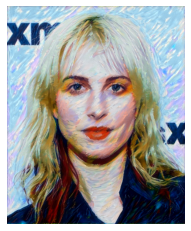

iteration: 1410 loss: 0.2434593608276644 time passed: 0:13:25.948609
iteration: 1420 loss: 0.30441804846938775 time passed: 0:13:30.755372
iteration: 1430 loss: 0.2566370642006803 time passed: 0:13:37.879733
iteration: 1440 loss: 0.23938109410430838 time passed: 0:13:42.122487
iteration: 1450 loss: 0.23462797619047618 time passed: 0:13:49.805031


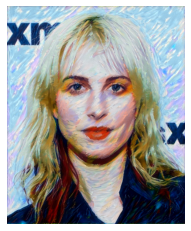

iteration: 1460 loss: 0.23084725765306122 time passed: 0:13:53.955703
iteration: 1470 loss: 0.22876211734693877 time passed: 0:13:59.318358
iteration: 1480 loss: 0.22519653486394559 time passed: 0:14:05.890716
iteration: 1490 loss: 0.22261346726190476 time passed: 0:14:10.674145
iteration: 1500 loss: 0.22297135416666666 time passed: 0:14:17.786945


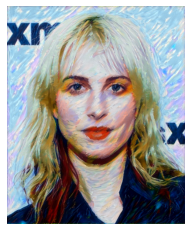

iteration: 1510 loss: 0.25809027777777777 time passed: 0:14:22.183952
iteration: 1520 loss: 0.23507706207482992 time passed: 0:14:29.884739
iteration: 1530 loss: 0.22020828018707483 time passed: 0:14:33.894536
iteration: 1540 loss: 0.2155687358276644 time passed: 0:14:39.258530
iteration: 1550 loss: 0.2127469706632653 time passed: 0:14:45.846282


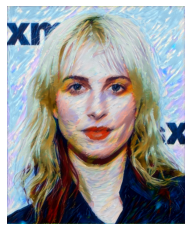

iteration: 1560 loss: 0.21902841553287983 time passed: 0:14:50.818127
iteration: 1570 loss: 0.20789262684240362 time passed: 0:14:57.953402
iteration: 1580 loss: 0.20650396825396825 time passed: 0:15:02.195848
iteration: 1590 loss: 0.204929652069161 time passed: 0:15:09.923550
iteration: 1600 loss: 0.2027796910430839 time passed: 0:15:13.933674


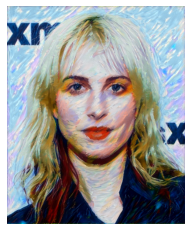

iteration: 1610 loss: 0.2022124433106576 time passed: 0:15:19.457736
iteration: 1620 loss: 0.20243856292517007 time passed: 0:15:26.062883
iteration: 1630 loss: 0.1995093891723356 time passed: 0:15:30.888421
iteration: 1640 loss: 0.19971896258503402 time passed: 0:15:38.015696
iteration: 1650 loss: 0.19572893636621316 time passed: 0:15:42.250663


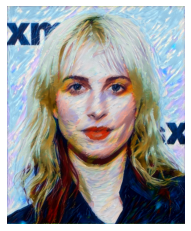

iteration: 1660 loss: 0.19263855229591836 time passed: 0:15:50.102836
iteration: 1670 loss: 0.19074930909863946 time passed: 0:15:54.107683
iteration: 1680 loss: 0.22708248299319728 time passed: 0:15:59.479703
iteration: 1690 loss: 0.1922907631802721 time passed: 0:16:06.064431
iteration: 1700 loss: 0.270468572845805 time passed: 0:16:10.870315


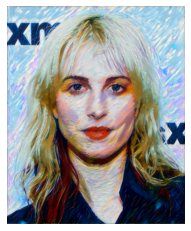

iteration: 1710 loss: 0.34472867063492063 time passed: 0:16:18.274032
iteration: 1720 loss: 0.24285191680839002 time passed: 0:16:22.524850
iteration: 1730 loss: 0.29186745323129254 time passed: 0:16:30.223701
iteration: 1740 loss: 0.24650201955782314 time passed: 0:16:34.229512
iteration: 1750 loss: 0.20446915745464853 time passed: 0:16:39.606359


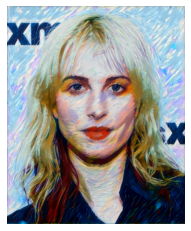

iteration: 1760 loss: 0.19055989583333333 time passed: 0:16:46.351231
iteration: 1770 loss: 0.18445588860544218 time passed: 0:16:51.150287
iteration: 1780 loss: 0.18077701601473922 time passed: 0:16:58.284865
iteration: 1790 loss: 0.17896786422902494 time passed: 0:17:02.519992
iteration: 1800 loss: 0.1756611040249433 time passed: 0:17:10.235906


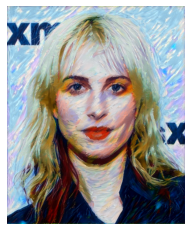

iteration: 1810 loss: 0.17327148880385487 time passed: 0:17:14.404737
iteration: 1820 loss: 0.17239570932539683 time passed: 0:17:19.771417
iteration: 1830 loss: 0.1697433567176871 time passed: 0:17:26.361708
iteration: 1840 loss: 0.16861658517573697 time passed: 0:17:31.176109
iteration: 1850 loss: 0.16676365858843537 time passed: 0:17:38.303927


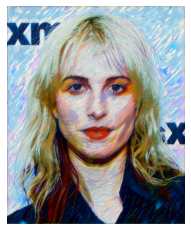

iteration: 1860 loss: 0.16956637967687074 time passed: 0:17:42.690772
iteration: 1870 loss: 0.16659435232426303 time passed: 0:17:50.399952
iteration: 1880 loss: 0.16253473993764173 time passed: 0:17:54.399369
iteration: 1890 loss: 0.16134233276643992 time passed: 0:17:59.746943
iteration: 1900 loss: 0.15973407383786847 time passed: 0:18:06.336669


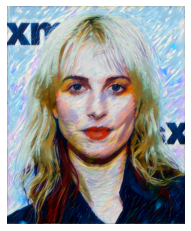

iteration: 1910 loss: 0.16048680201247165 time passed: 0:18:11.321804
iteration: 1920 loss: 0.1577936507936508 time passed: 0:18:18.449341
iteration: 1930 loss: 0.16204102891156463 time passed: 0:18:22.707103
iteration: 1940 loss: 0.18677689200680272 time passed: 0:18:30.418197
iteration: 1950 loss: 0.1581108276643991 time passed: 0:18:34.416741


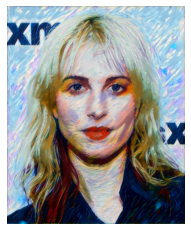

iteration: 1960 loss: 0.15420569373582765 time passed: 0:18:39.935588
iteration: 1970 loss: 0.15266057256235827 time passed: 0:18:46.526623
iteration: 1980 loss: 0.15238527494331067 time passed: 0:18:51.318317
iteration: 1990 loss: 0.1494750212585034 time passed: 0:18:58.455411
iteration: 2000 loss: 0.14753243693310658 time passed: 0:19:02.698981


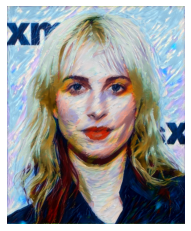

iteration: 2010 loss: 0.14861522108843536 time passed: 0:19:10.542365
iteration: 2020 loss: 0.14633708900226758 time passed: 0:19:14.545430
iteration: 2030 loss: 0.1451108099489796 time passed: 0:19:19.913010
iteration: 2040 loss: 0.14286143884637187 time passed: 0:19:26.472634
iteration: 2050 loss: 0.14316871279761906 time passed: 0:19:31.296943


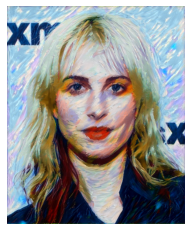

iteration: 2060 loss: 0.14524784757653061 time passed: 0:19:38.601934
iteration: 2070 loss: 0.14301090384070295 time passed: 0:19:42.852953
iteration: 2080 loss: 0.14062762188208616 time passed: 0:19:50.575937
iteration: 2090 loss: 0.13950240929705215 time passed: 0:19:54.567329
iteration: 2100 loss: 0.14005382830215418 time passed: 0:19:59.933617


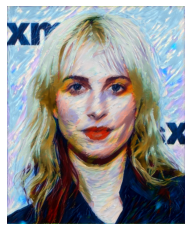

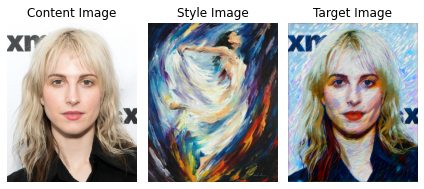

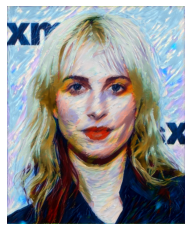

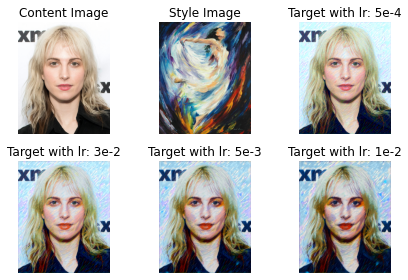

In [5]:
# HYPERPARAMETERS
# style content ratio: alpha represents content image weight and beta represents style image weight
content_weight = 1
style_weight = 1e6      # (1e1, 1e6)

# learning rate
learning_rates = [0.0005, 0.002, 0.005, 0.01]

# steps, iterations
steps = 2100
# additional_steps = 100

# MAIN

# get content and style images
content_image = load_image(content_image_path).to(device=device)
style_image_path = select_image_from_dataset(dataset_directory_artists, dataset_directory_van_gogh)
style_image = load_image(style_image_path, shape=content_image.shape[-2:]).to(device=device)

# get VGG19 pre-trained model
model = get_model()

target_images = []
names = ['Content Image', 'Style Image', 'Target with lr: 5e-4', 'Target with lr: 3e-2', 'Target with lr: 5e-3', 'Target with lr: 1e-2']

for learning_rate in learning_rates:
  print('Training is started for learning rate:', learning_rate)
  SF = Supporting_Functions(log_filename, content_image_path, '/from dataset', device, content_weight, style_weight, learning_rate, steps, storage_limit)
  SF.enter_log('Content and Style images are retrieved.', header=True)

  # plot content and style images
  SF.plot_images([content_image, style_image])

  # train target image
  target_image, images = train(model, content_image, style_image, steps, content_weight, style_weight, learning_rate)
  target_images.append(target_image)

  # plot content, style, and target images
  SF.plot_images([content_image, style_image, target_image])

  # save target image
  SF.save_image(target_image, 'target_image' + str(style_weight) + '.jpg')

  # create video
  SF.create_video(images, 'transformation_with_' + str(style_weight))

plot_images_bunch(np.concatenate(([content_image, style_image], target_images)), names, nrows=2)